<a href="https://colab.research.google.com/github/geoburdin/core_samples/blob/master/segmentation_demonstration.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import math
from skimage.segmentation import felzenszwalb
from skimage.segmentation import mark_boundaries
from skimage import measure, color
import pandas as pd
from skimage.future import graph
from google.colab.patches import cv2_imshow

def _weight_mean_color(graph, src, dst, n):
    """Callback to handle merging nodes by recomputing mean color.

    The method expects that the mean color of `dst` is already computed.

    Parameters
    ----------
    graph : RAG
        The graph under consideration.
    src, dst : int
        The vertices in `graph` to be merged.
    n : int
        A neighbor of `src` or `dst` or both.

    Returns
    -------
    data : dict
        A dictionary with the `"weight"` attribute set as the absolute
        difference of the mean color between node `dst` and `n`.
    """

    diff = graph.nodes[dst]['mean color'] - graph.nodes[n]['mean color']
    diff = np.linalg.norm(diff)
    return {'weight': diff}


def merge_mean_color(graph, src, dst):
    """Callback called before merging two nodes of a mean color distance graph.

    This method computes the mean color of `dst`.

    Parameters
    ----------
    graph : RAG
        The graph under consideration.
    src, dst : int
        The vertices in `graph` to be merged.
    """
    
    graph.nodes[dst]['total color'] += graph.nodes[src]['total color']
    graph.nodes[dst]['pixel count'] += graph.nodes[src]['pixel count']
    graph.nodes[dst]['mean color'] = (graph.nodes[dst]['total color'] /
                                      graph.nodes[dst]['pixel count'])


import cv2, numpy as np
from sklearn.cluster import KMeans

def visualize_colors(cluster, centroids):
    # Get the number of different clusters, create histogram, and normalize
    labels = np.arange(0, len(np.unique(cluster.labels_)) + 1)
    (hist, _) = np.histogram(cluster.labels_, bins = labels)
    hist = hist.astype("float")
    hist /= hist.sum()

    # Create frequency rect and iterate through each cluster's color and percentage
    rect = np.zeros((50, 300, 3), dtype=np.uint8)
    colors = sorted([(percent, color) for (percent, color) in zip(hist, centroids)])
    start = 0
    for (percent, color) in colors:
        print(color, "{:0.2f}%".format(percent * 100))
        end = start + (percent * 300)
        cv2.rectangle(rect, (int(start), 0), (int(end), 50), \
                      color.astype("uint8").tolist(), -1)
        start = end
    return rect

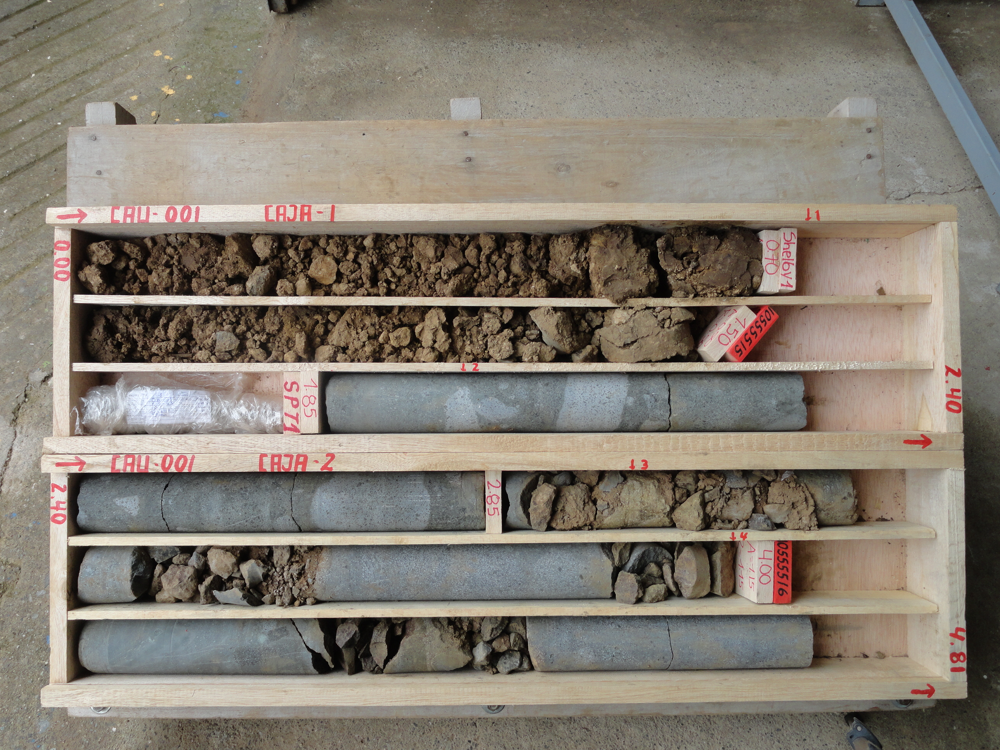

In [2]:
path_to_image = '/content/drive/MyDrive/2020_Agreement AngloGold/CAU-001/ORIGINALES/DSC02998.JPG'
img = cv2.imread(path_to_image)

height, width = img.shape[:2]
if height>width:
    img = cv2.rotate(img, cv2.ROTATE_90_CLOCKWISE)
cv2_imshow(img)


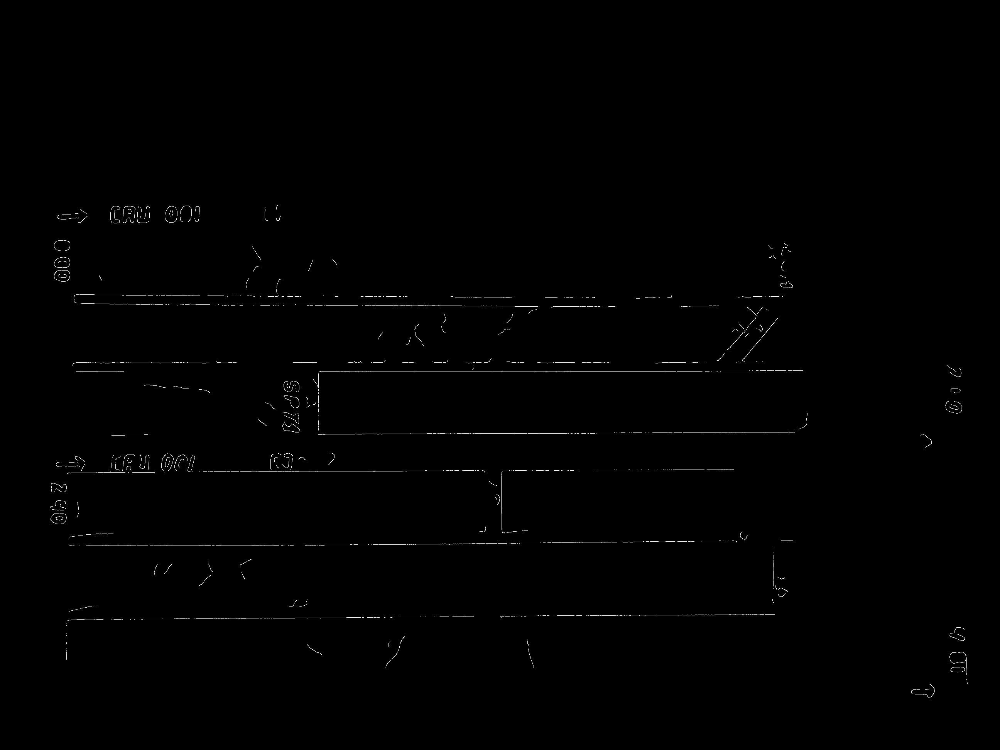

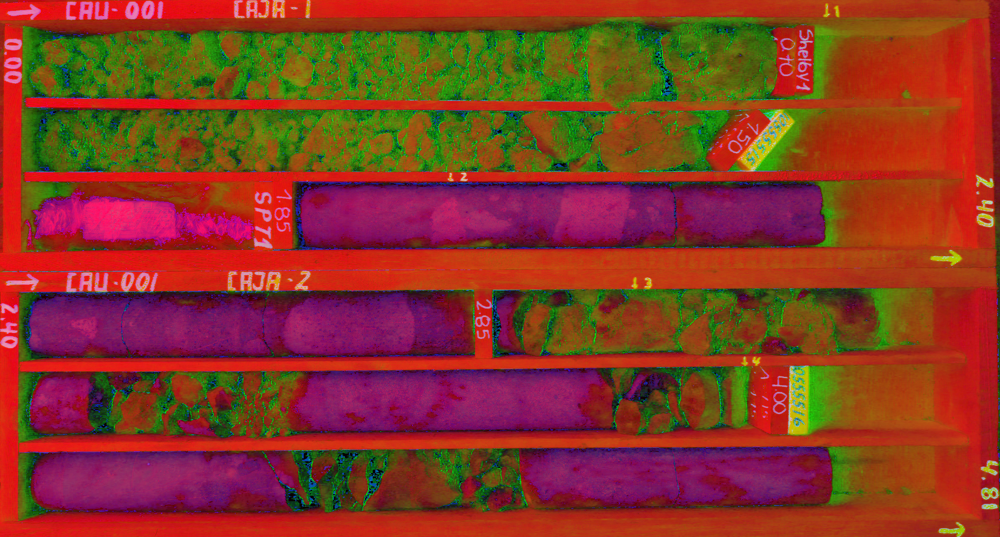

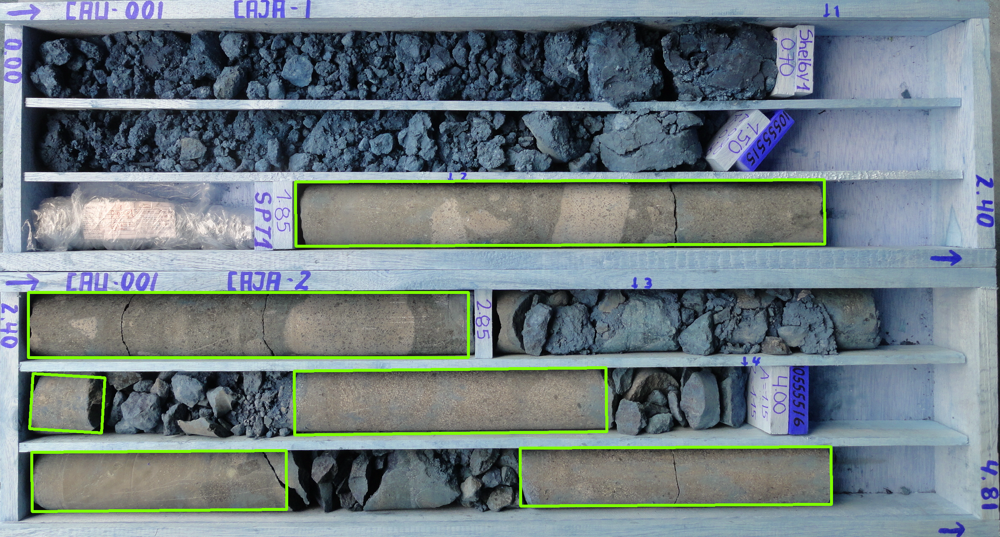

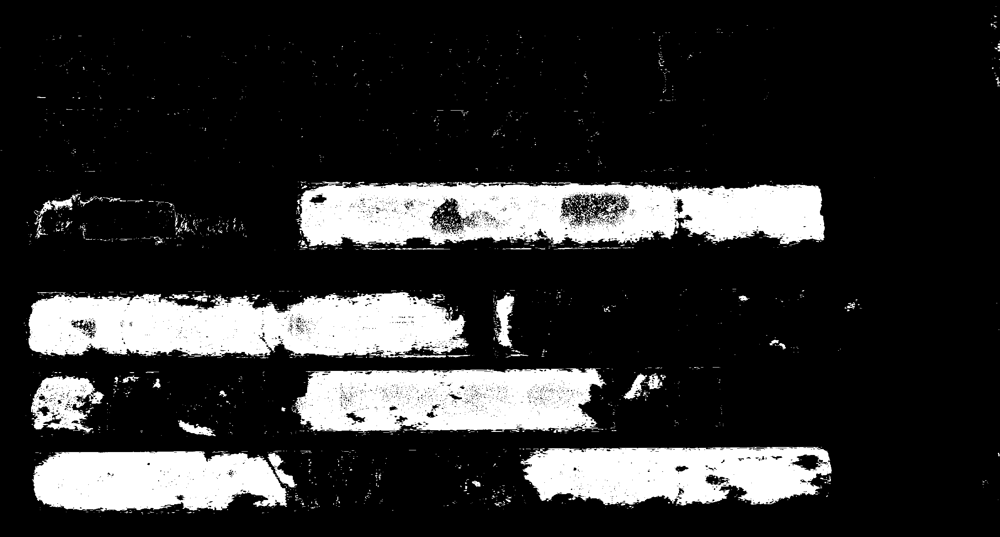

[[76, 1073, 606, 143], [1237, 1063, 740, 139], [74, 893, 174, 135], [700, 875, 742, 154], [67, 695, 1047, 156], [703, 432, 1258, 154]]


In [3]:
img = cv2.cvtColor(img, cv2.COLOR_BGR2HSV) #convert to hsv

blurred = cv2.GaussianBlur(img, (21,21), 0)

#locate the box using Canny edge detection operator
canny = cv2.Canny(blurred, 100, 150, apertureSize = 3)
cv2_imshow(canny)
pts = np.argwhere(canny>0)
y1,x1 = pts.min(axis=0)
y2,x2 = pts.max(axis=0)
# crop the box
cropped_orig = img[y1:y2, x1:x2]
cv2_imshow(cropped_orig)
box_img = cropped_orig.copy()
#min and max are the boundaries which the cv2.inRange function will apply to hsv (hue, saturation, value) format to get an threshhold image
#min and max are approximate and will need to be defined more precisely if accuracy of other samples is poor
min = np.array((50, 0, 0), np.uint8)
max = np.array((160, 170, 170), np.uint8)
#threshold by color
thresh = cv2.inRange(cropped_orig, min, max)
#find the contours. Maybe useful to check other methods of approximation 
contours0, hierarchy = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
contours_x_y_w_h = []
# check all contours
for cnt in contours0:
    if len(cnt)>400:
        [X, Y, W, H] = cv2.boundingRect(cnt)
        
        rect = cv2.minAreaRect(cnt) # try to set an rectangle
        box = cv2.boxPoints(rect) # find 4 points
        box = np.int0(box) # coordinate rounding

        area = int(rect[1][0]*rect[1][1]) # area of rectangle
        if area > 10000 and area < 500000: # if the area of rechtangle is big enough
            cv2.drawContours(cropped_orig,[box],0,(255,255,255),5) # draw it
            contours_x_y_w_h.append([X, Y, W, H])
        

#show contours and thresh
cropped_orig = cv2.cvtColor(cropped_orig, cv2.COLOR_HSV2RGB)
cv2_imshow(cropped_orig)
cv2_imshow(thresh)
print(contours_x_y_w_h)
  

In [4]:
for i in contours_x_y_w_h:
    print(i)

[76, 1073, 606, 143]
[1237, 1063, 740, 139]
[74, 893, 174, 135]
[700, 875, 742, 154]
[67, 695, 1047, 156]
[703, 432, 1258, 154]


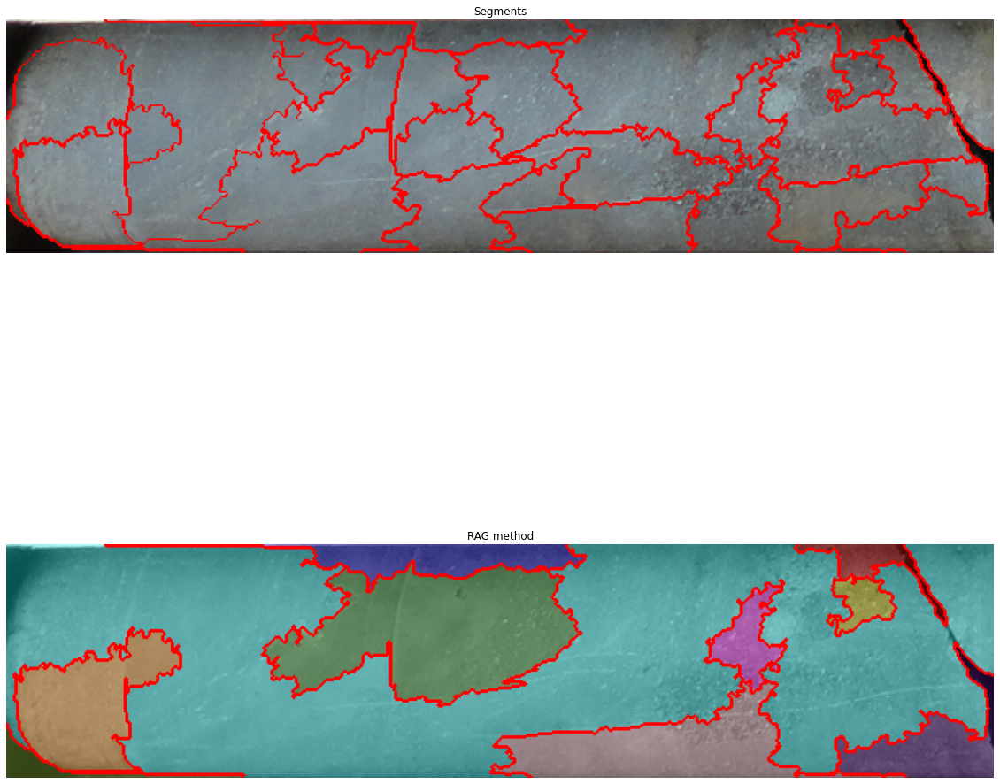

   centroid-0  centroid-1  ...    perimeter  eccentricity
0          11         531  ...   282.515765      0.934480
1           7         258  ...   574.066017      0.994758
2          35         524  ...   187.610173      0.503009
3          58         455  ...   295.835570      0.759314
4          53         261  ...   741.446789      0.906212
5         122         566  ...   445.214249      0.852306
6          97          50  ...   472.670094      0.748601
7          67         303  ...  3298.672365      0.975700
8         124         403  ...   700.427453      0.971273
9         135          36  ...   334.390873      0.989963

[10 rows x 9 columns]
[ 1  2  3  4  5  6  7  8  9 10]
dominant colors: [[9.8299995e+01 1.0142000e+02 9.8025002e+01]
 [7.8292953e+01 7.7383095e+01 7.1123940e+01]
 [3.2559226e-03 1.7971758e-03 9.8027778e-04]
 [2.2044586e+01 1.6630573e+01 1.5197453e+01]
 [6.1914062e+01 5.9324219e+01 5.3449219e+01]]


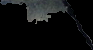

[22.74534161 17.32919255 15.88819876] 3.46%
[ 99.13186813 102.61538462  99.36813187] 3.91%
[63.48310811 61.21959459 55.16216216] 6.37%
[80.05182927 79.14634146 73.        ] 7.05%
[0.07928319 0.04344285 0.02497964] 79.20%


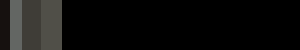

dominant colors: [[  0.         0.         0.      ]
 [199.25002  194.3393   178.79465 ]
 [ 95.05868  101.094215 103.717354]
 [ 79.783295  83.263626  85.11594 ]
 [153.48718  133.53847  126.85898 ]]


[150.39506173 129.87654321 123.7654321 ] 0.95%
[198.5        193.26724138 177.93965517] 1.36%
[ 94.29185868 100.35714286 102.99923195] 15.23%
[79.21407407 82.63037037 84.42962963] 15.77%
[2.76756396e-12 1.27897692e-13 4.27036184e-12] 66.70%


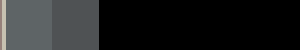

dominant colors: [[113.95556  119.95556  121.183334]
 [ 91.34553   95.75203   98.10569 ]
 [  0.         0.         0.      ]
 [101.98006  107.08832  109.19088 ]
 [ 77.18519   81.        82.98148 ]]


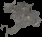

[77.18518519 81.         82.98148148] 3.47%
[113.95555556 119.95555556 121.18333333] 11.58%
[91.34552846 95.75203252 98.10569106] 15.83%
[101.98005698 107.08831909 109.19088319] 22.59%
[-1.03028697e-12  6.18172180e-13  9.30810984e-13] 46.53%


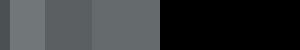

dominant colors: [[126.8501  139.62808 144.2296 ]
 [  0.        0.        0.     ]
 [119.08747 130.02583 133.99005]
 [110.63319 119.0262  121.98254]
 [140.07742 152.34839 156.41936]]


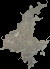

[140.73943662 152.92253521 156.95070423] 4.12%
[110.46188341 118.86547085 121.86547085] 6.23%
[119.0591716  129.95069034 133.8678501 ] 14.99%
[126.96863469 139.76199262 144.37453875] 15.65%
[-1.10844667e-12  1.62714286e-12 -8.10018719e-13] 59.01%


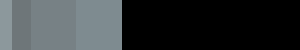

dominant colors: [[134.83861  150.51532  158.39491 ]
 [124.55702  139.81122  148.10988 ]
 [  0.         0.         0.      ]
 [104.155846 114.07662  119.42727 ]
 [113.94572  127.026085 133.60512 ]]


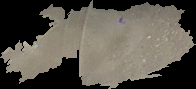

[136.19262865 151.97774687 159.68289291] 8.24%
[107.33465347 118.37887789 124.02970297] 8.68%
[118.86393386 133.4801929  141.14708922] 16.55%
[126.6835202  141.95663211 150.33784641] 27.19%
[ 1.69109171e-12  6.28119778e-12 -1.06865627e-11] 39.33%


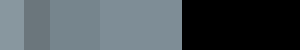

dominant colors: [[9.90241928e+01 1.01191536e+02 9.68198929e+01]
 [6.25864277e-03 5.18573262e-03 5.18573262e-03]
 [1.09664940e+02 1.13404144e+02 1.10208984e+02]
 [2.29609375e+01 2.06679688e+01 1.99375000e+01]
 [8.54390259e+01 8.42172928e+01 7.94745026e+01]]


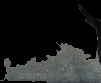

[22.55905512 20.25984252 19.55511811] 3.03%
[81.95681063 80.19933555 75.76744186] 3.57%
[107.43855693 110.96843292 107.45434047] 10.69%
[97.20030008 98.87621905 94.33833458] 15.82%
[0.0918331  0.07578459 0.07542796] 66.90%


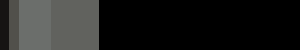

dominant colors: [[116.99608 116.60315 112.51867]
 [134.17128 145.25752 149.84837]
 [ 92.86813  90.91759  82.41759]
 [125.73188 134.65672 138.74147]
 [  0.        0.        0.     ]]


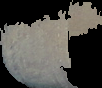

[96.94071146 95.17391304 87.64031621] 2.81%
[121.51432292 122.6640625  119.91666667] 8.56%
[135.31703551 146.50128667 151.01595471] 21.65%
[126.96754177 137.30739857 142.4300716 ] 23.35%
[0.01225428 0.01148838 0.0099566 ] 43.64%


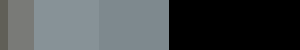

dominant colors: [[118.17529    126.43234    128.91136   ]
 [  0.4039434    0.36319113   0.32862392]
 [129.60025    141.95813    146.87222   ]
 [ 81.30087     82.01743     79.82664   ]
 [105.350876   109.64169    109.11818   ]]


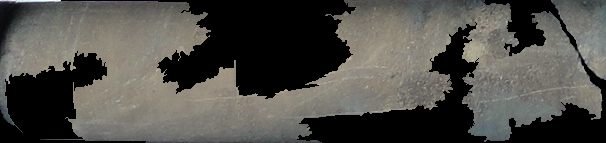

[79.81800807 80.28923338 78.02420896] 5.46%
[103.87377512 107.98613187 107.37186514] 13.87%
[129.35847435 141.69320441 146.60472737] 21.53%
[117.63345671 125.55279663 127.75992186] 22.40%
[0.38957286 0.34927764 0.31557789] 36.74%


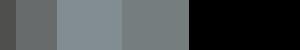

dominant colors: [[117.375145 124.43616  126.06667 ]
 [  0.         0.         0.      ]
 [104.425476 108.00297  107.85095 ]
 [ 93.41895   95.39869   93.97062 ]
 [ 79.02023   76.57081   73.93497 ]]


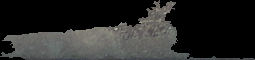

[79.63720317 77.44591029 74.83641161] 4.97%
[118.01884422 125.34045226 127.00251256] 5.26%
[94.28264925 96.4244403  95.09514925] 13.99%
[105.27173913 108.95289855 108.92889493] 14.37%
[ 8.73967565e-13 -4.40536496e-12  6.08224582e-12] 61.40%


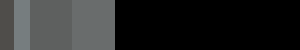

dominant colors: [[2.0967047e-04 1.1648360e-04 1.1648360e-04]
 [3.6367817e+01 2.8609196e+01 2.6862068e+01]
 [5.6116074e+01 4.7991074e+01 4.6821430e+01]
 [7.2254539e+01 6.5327271e+01 6.4609085e+01]
 [1.7500000e+01 1.3352000e+01 1.1516001e+01]]


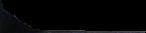

[30.41818182 22.86363636 20.4       ] 2.28%
[52.52542373 44.33050847 43.49152542] 2.45%
[70.9140625 63.96875   63.0859375] 2.66%
[16.61368653 12.78587196 11.02649007] 9.40%
[0.0044899  0.00249439 0.00249439] 83.21%


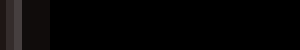

10
   centroid-0  ...                                    pallete colours
0          11  ...  [[98.299995, 101.42, 98.025], [78.29295, 77.38...
1           7  ...  [[0.0, 0.0, 0.0], [199.25002, 194.3393, 178.79...
2          35  ...  [[113.95556, 119.95556, 121.183334], [91.34553...
3          58  ...  [[126.8501, 139.62808, 144.2296], [0.0, 0.0, 0...
4          53  ...  [[134.83861, 150.51532, 158.39491], [124.55702...
5         122  ...  [[99.02419, 101.191536, 96.81989], [0.00625864...
6          97  ...  [[116.99608, 116.60315, 112.51867], [134.17128...
7          67  ...  [[118.17529, 126.43234, 128.91136], [0.4039434...
8         124  ...  [[117.375145, 124.43616, 126.06667], [0.0, 0.0...
9         135  ...  [[0.00020967047, 0.0001164836, 0.0001164836], ...

[10 rows x 10 columns]


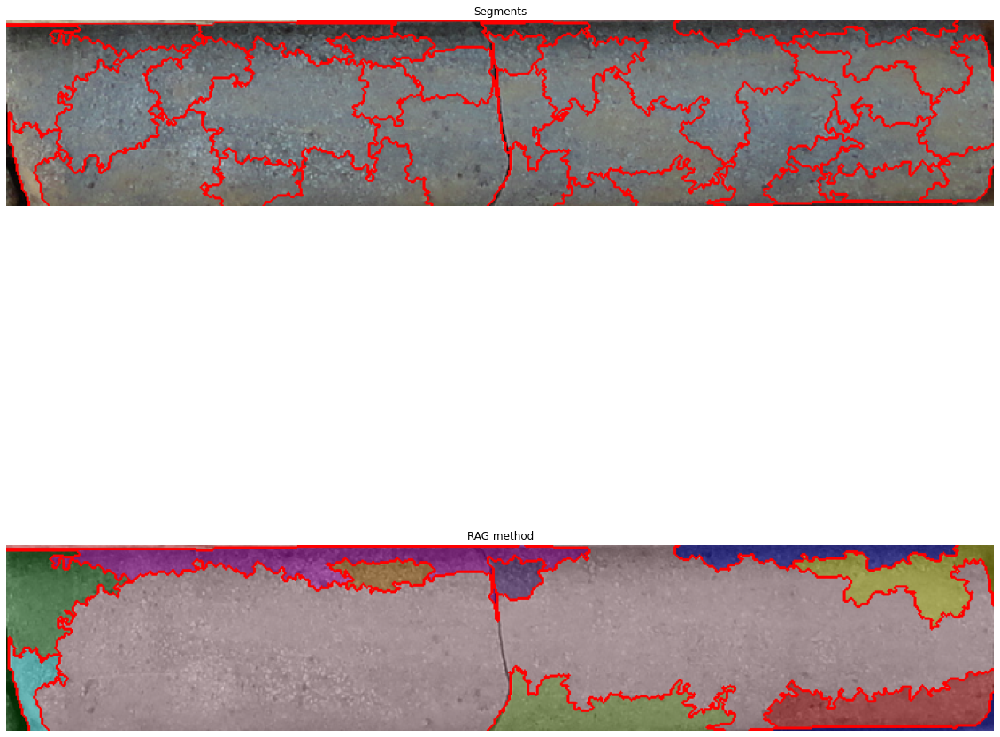

    centroid-0  centroid-1  ...    perimeter  eccentricity
0            0         144  ...   602.035534      0.999972
1            6         601  ...   534.592929      0.997281
2           24         676  ...   626.587878      0.936930
3           10         231  ...  1227.180808      0.997719
4           46          28  ...   659.404112      0.833733
5           23         381  ...   150.604076      0.622185
6           21         282  ...   247.551299      0.952593
7          101          19  ...   269.616270      0.808559
8           74         364  ...  2823.660172      0.986455
9          123         446  ...   682.167568      0.979499
10         120         661  ...   555.747258      0.983981
11         135         675  ...   389.177670      0.996540

[12 rows x 9 columns]
[ 1  2  3  4  5  6  7  8  9 10 11 12]
dominant colors: [[102.5      85.00862  80.18104]
 [160.88553 145.43373 129.86746]
 [134.92697 115.23034 105.41573]
 [  0.        0.        0.     ]
 [187.10289 179.91318 1

[104.12598425  86.40944882  81.22047244] 8.27%
[168.06735751 156.60621762 137.35751295] 12.57%
[139.27014218 119.44549763 109.16113744] 13.74%
[190.65       183.60416667 156.88333333] 15.62%
[-8.38440428e-13  6.96331881e-13  4.54747351e-13] 49.80%


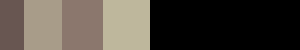

dominant colors: [[85.91151  92.42036  96.31858 ]
 [74.614265 78.687386 81.38209 ]
 [ 0.        0.        0.      ]
 [65.876045 67.18236  69.20739 ]
 [56.73077  57.21274  58.850964]]


[84.39249147 90.68600683 94.37883959] 6.79%
[55.06643952 55.51788756 57.22657581] 13.84%
[72.9687011  76.38967136 78.79029734] 15.19%
[63.80756757 64.78162162 66.72540541] 21.82%
[-5.32907052e-13 -1.77635684e-13 -8.88178420e-13] 42.36%


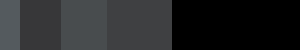

dominant colors: [[7.67084045e+01 8.02558136e+01 8.20518799e+01]
 [9.78605804e+01 1.02004013e+02 1.01917755e+02]
 [2.92923389e-04 2.02016119e-04 1.51512097e-04]
 [5.32919273e+01 4.22453423e+01 3.69316788e+01]
 [1.17108589e+02 1.20308594e+02 1.14512123e+02]]


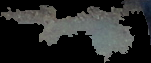

[53.29192547 42.24534161 36.93167702] 3.40%
[77.11986301 80.7140411  82.56335616] 6.13%
[ 98.6503428  102.70714985 102.41038198] 10.66%
[117.32884516 120.54427758 114.67374417] 20.37%
[0.00512821 0.00353669 0.00265252] 59.44%


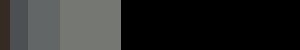

dominant colors: [[4.04274929e-03 5.04825357e-03 5.65984892e-03]
 [8.28440247e+01 8.76142120e+01 9.07936478e+01]
 [6.57964172e+01 6.85760956e+01 6.97018280e+01]
 [1.04648186e+02 1.11827911e+02 1.15858505e+02]
 [5.04989204e+01 5.21789207e+01 5.28227043e+01]]


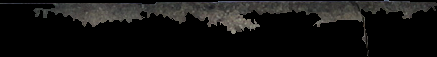

[102.52208202 109.53154574 113.58044164] 2.55%
[81.23160027 85.80013504 88.85347738] 5.90%
[50.39923119 52.04942339 52.67819879] 7.32%
[65.23258656 67.96211813 69.00651731] 9.89%
[0.02106059 0.02629874 0.02948483] 74.34%


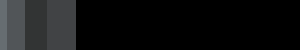

dominant colors: [[8.30427322e+01 8.48717957e+01 8.16524200e+01]
 [1.06803452e+02 1.10981384e+02 1.10726898e+02]
 [1.27760841e+02 1.31912674e+02 1.30674637e+02]
 [5.14802742e+01 4.89159546e+01 4.38782158e+01]
 [3.82499211e-02 2.50694100e-02 1.86317079e-02]]


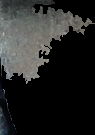

[51.75216638 49.25996534 44.2305026 ] 4.50%
[83.06562054 84.89871612 81.67760342] 5.50%
[106.74722992 110.93836565 110.69944598] 11.27%
[127.73614191 131.87749446 130.63026608] 14.02%
[0.47957585 0.31642367 0.23569105] 64.71%


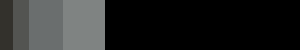

dominant colors: [[  0.         0.         0.      ]
 [ 73.1134    80.54639   82.360825]
 [ 99.51056  106.69014  109.936615]
 [ 85.927536  93.64251   96.623184]
 [114.9723   122.62881  124.598335]]


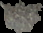

[76.0516129  83.67741935 85.80645161] 10.92%
[120.0952381  128.32738095 129.94047619] 11.84%
[ 91.33333333  98.77659574 101.9893617 ] 19.87%
[107.34011628 114.48255814 117.15406977] 24.24%
[ 6.11066753e-13  2.98427949e-13 -4.83169060e-13] 33.12%


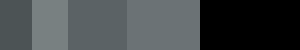

dominant colors: [[101.81694  109.04645  113.05464 ]
 [ 91.08159   97.311714 101.42677 ]
 [  0.         0.         0.      ]
 [ 76.079544  82.41288   85.81061 ]
 [115.20193  123.33654  127.067314]]


[112.64666667 120.82666667 124.7       ] 7.03%
[75.40740741 81.78600823 85.22633745] 11.54%
[100.26804124 107.14175258 111.18814433] 18.52%
[ 89.89095128  96.15081206 100.16937355] 20.47%
[-1.00897068e-12  9.94759830e-14 -2.55795385e-13] 42.45%


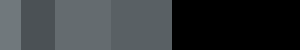

dominant colors: [[  0.        0.        0.     ]
 [109.57831 100.10843  89.01205]
 [159.82825 151.1579  134.26593]
 [123.27508 120.98281 118.27221]
 [141.13588 135.33514 124.11232]]


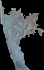

[109.48684211  99.27631579  87.38157895] 2.44%
[122.28614458 120.25301205 118.11445783] 10.81%
[159.52845528 151.00271003 134.29539295] 12.01%
[140.73415493 134.88732394 123.65316901] 18.41%
[-8.31335001e-13  1.90425453e-12 -3.48165941e-13] 56.33%


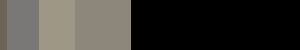

dominant colors: [[7.33015823e+01 7.59890289e+01 7.75267792e+01]
 [3.11858188e-02 3.18493471e-02 3.69363949e-02]
 [1.27110771e+02 1.35759888e+02 1.37807449e+02]
 [1.16081444e+02 1.22406578e+02 1.23424240e+02]
 [1.02792953e+02 1.06837975e+02 1.07650528e+02]]


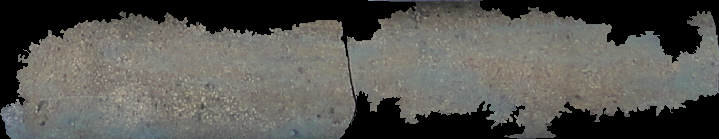

[78.16814721 80.9552665  82.2268401 ] 3.13%
[127.99534028 136.73261803 138.80490497] 16.34%
[104.84134404 109.14072811 109.93928729] 18.12%
[0.04686848 0.04836465 0.05494085] 28.76%
[117.09244524 123.67772314 124.79719863] 33.65%


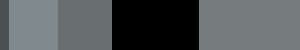

dominant colors: [[1.07934700e+02 1.10004448e+02 1.07303864e+02]
 [1.17275345e+02 1.21653076e+02 1.21133194e+02]
 [2.59650336e-03 2.31139711e-03 2.19939114e-03]
 [9.74335938e+01 9.73523483e+01 9.37609406e+01]
 [7.32368393e+01 7.18070145e+01 6.90438614e+01]]


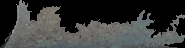

[72.95495495 71.44144144 68.69369369] 1.25%
[117.28171828 121.67632368 121.18381618] 11.34%
[97.32670906 97.20826709 93.56597774] 14.10%
[107.87812363 109.94476107 107.25558965] 25.69%
[0.06029794 0.05367699 0.0510759 ] 47.62%


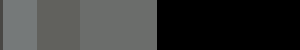

dominant colors: [[  0.         0.         0.      ]
 [107.07613  107.91779  101.37692 ]
 [ 78.732216  76.42259   72.66109 ]
 [116.88359  119.60088  113.870285]
 [ 94.640755  95.445175  92.30196 ]]


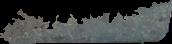

[78.73221757 76.42259414 72.66108787] 3.17%
[117.06536697 119.81307339 114.06766055] 11.47%
[94.9170579  95.71752739 92.49608764] 16.87%
[107.30260047 108.16170213 101.59574468] 28.00%
[3.35376171e-12 1.60582658e-12 2.40873987e-12] 40.49%


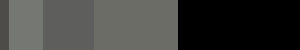

dominant colors: [[56.588497 45.402657 39.747787]
 [44.364998 36.62     34.28    ]
 [70.560974 60.430893 52.951218]
 [ 0.        0.        0.      ]
 [84.794876 78.28205  70.25641 ]]


[85.03947368 78.5        70.44736842] 1.43%
[70.90909091 60.84297521 53.27272727] 2.28%
[44.70243902 36.64878049 34.09756098] 3.86%
[56.65777778 45.70222222 40.18666667] 4.24%
[-4.36095604e-13 -3.25961480e-13  3.85469434e-13] 88.19%


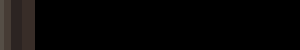

12
    centroid-0  ...                                    pallete colours
0            0  ...  [[102.5, 85.00862, 80.18104], [160.88553, 145....
1            6  ...  [[85.91151, 92.42036, 96.31858], [74.614265, 7...
2           24  ...  [[76.708405, 80.25581, 82.05188], [97.86058, 1...
3           10  ...  [[0.0040427493, 0.0050482536, 0.005659849], [8...
4           46  ...  [[83.04273, 84.871796, 81.65242], [106.80345, ...
5           23  ...  [[0.0, 0.0, 0.0], [73.1134, 80.54639, 82.36082...
6           21  ...  [[101.81694, 109.04645, 113.05464], [91.08159,...
7          101  ...  [[0.0, 0.0, 0.0], [109.57831, 100.10843, 89.01...
8           74  ...  [[73.30158, 75.98903, 77.52678], [0.031185819,...
9          123  ...  [[107.9347, 110.00445, 107.30386], [117.275345...
10         120  ...  [[0.0, 0.0, 0.0], [107.07613, 107.91779, 101.3...
11         135  ...  [[56.588497, 45.402657, 39.747787], [44.364998...

[12 rows x 10 columns]


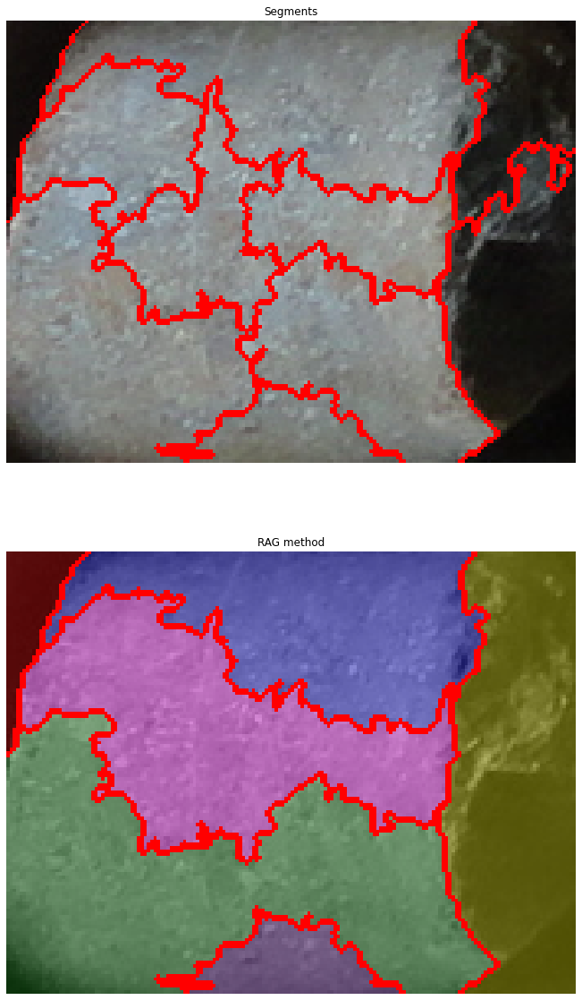

   centroid-0  centroid-1  ...   perimeter  eccentricity
0          19           6  ...  155.941125      0.956374
1          21          92  ...  457.398016      0.914591
2          67         155  ...  370.403066      0.959162
3          54          64  ...  583.665043      0.890897
4         100          61  ...  639.345238      0.901966
5         125          85  ...  204.982756      0.911699

[6 rows x 9 columns]
[1 2 3 4 5 6]
dominant colors: [[1.11000000e+02 1.05000000e+02 1.04200005e+02]
 [4.40499992e+01 3.54000015e+01 3.38500023e+01]
 [1.44426455e-03 7.87780620e-04 2.62593559e-04]
 [1.86380157e+01 1.36049585e+01 1.21438017e+01]
 [7.38181839e+01 6.32727280e+01 6.24545479e+01]]


[111.  105.  104.2] 0.32%
[70.35714286 59.92857143 59.14285714] 0.90%
[37.76923077 29.61538462 28.03846154] 1.68%
[18.45973154 13.46644295 12.0033557 ] 38.45%
[0.03630363 0.01980198 0.00660066] 58.65%


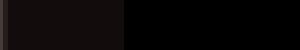

dominant colors: [[2.23849155e-02 2.06467919e-02 1.91193502e-02]
 [1.29615860e+02 1.35634140e+02 1.37570724e+02]
 [1.12327393e+02 1.14583488e+02 1.12433395e+02]
 [1.47543274e+02 1.54077271e+02 1.55486862e+02]
 [8.75337372e+01 8.78293686e+01 8.43075409e+01]]


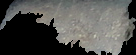

[82.24355301 81.89111748 78.51575931] 4.84%
[108.70921305 110.65738964 107.88867562] 13.76%
[146.75692964 153.26723525 154.73205402] 18.65%
[128.06428989 133.78316774 135.49094097] 23.03%
[0.06428812 0.0622686  0.0568832 ] 39.72%


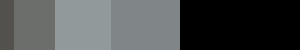

dominant colors: [[3.6344330e+01 3.5691753e+01 3.1854641e+01]
 [8.7667473e-02 7.9122268e-02 6.7042932e-02]
 [9.1102768e+01 9.3917000e+01 9.1533600e+01]
 [5.8542522e+01 5.9870968e+01 5.6904694e+01]
 [2.0443853e+01 1.8991245e+01 1.5869814e+01]]


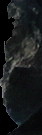

[91.50607287 94.32388664 91.96761134] 4.36%
[58.77565982 60.13636364 57.1627566 ] 11.99%
[36.41598361 35.76127049 31.93135246] 17.23%
[1.68894602 1.52784919 1.30162811] 20.58%
[20.55311778 19.09430331 15.95150115] 45.84%


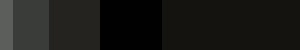

dominant colors: [[1.9841269e-03 1.8187830e-03 1.4880951e-03]
 [1.3320992e+02 1.3502214e+02 1.3397890e+02]
 [1.4308348e+02 1.4884038e+02 1.4989592e+02]
 [1.5425537e+02 1.6328024e+02 1.6529033e+02]
 [1.0217021e+02 9.9936165e+01 9.3659569e+01]]


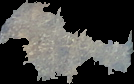

[120.07142857 118.49450549 114.42857143] 1.63%
[157.02210526 166.50947368 168.57894737] 8.44%
[137.1199284  140.3973747  140.27684964] 15.15%
[145.59243201 152.41623965 153.87899093] 22.26%
[0.01624091 0.01454915 0.01251903] 52.51%


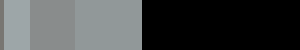

dominant colors: [[7.1723208e-02 5.9471775e-02 4.8944164e-02]
 [1.1037729e+02 1.1078096e+02 1.0674770e+02]
 [1.3323119e+02 1.3590811e+02 1.3320474e+02]
 [1.4723433e+02 1.5386977e+02 1.5443047e+02]
 [6.6849312e+01 6.3936069e+01 5.8931503e+01]]


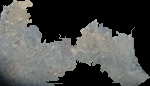

[77.09931507 74.44863014 69.54794521] 2.25%
[117.69788732 119.01549296 115.42957746] 10.94%
[149.04638619 156.47141316 157.61111111] 14.43%
[136.29156429 139.36418236 136.999454  ] 28.42%
[0.32675013 0.2782578  0.23717157] 43.96%


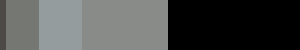

dominant colors: [[123.78042  128.28487  125.28487 ]
 [104.951355 105.24325   95.91351 ]
 [115.95625  117.74062  110.3     ]
 [  0.         0.         0.      ]
 [136.656    143.136    141.856   ]]


[137.16521739 143.76521739 142.54782609] 5.95%
[105.1761658  105.52331606  96.24352332] 9.74%
[124.32371795 129.11858974 126.37179487] 15.95%
[116.58789625 118.40634006 111.23054755] 17.95%
[ 4.40536496e-13 -5.82645043e-13 -6.46593890e-13] 50.41%


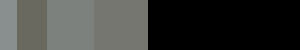

6
   centroid-0  ...                                    pallete colours
0          19  ...  [[111.0, 105.0, 104.200005], [44.05, 35.4, 33....
1          21  ...  [[0.022384916, 0.020646792, 0.01911935], [129....
2          67  ...  [[36.34433, 35.691753, 31.854641], [0.08766747...
3          54  ...  [[0.0019841269, 0.001818783, 0.0014880951], [1...
4         100  ...  [[0.07172321, 0.059471775, 0.048944164], [110....
5         125  ...  [[123.78042, 128.28487, 125.28487], [104.95135...

[6 rows x 10 columns]


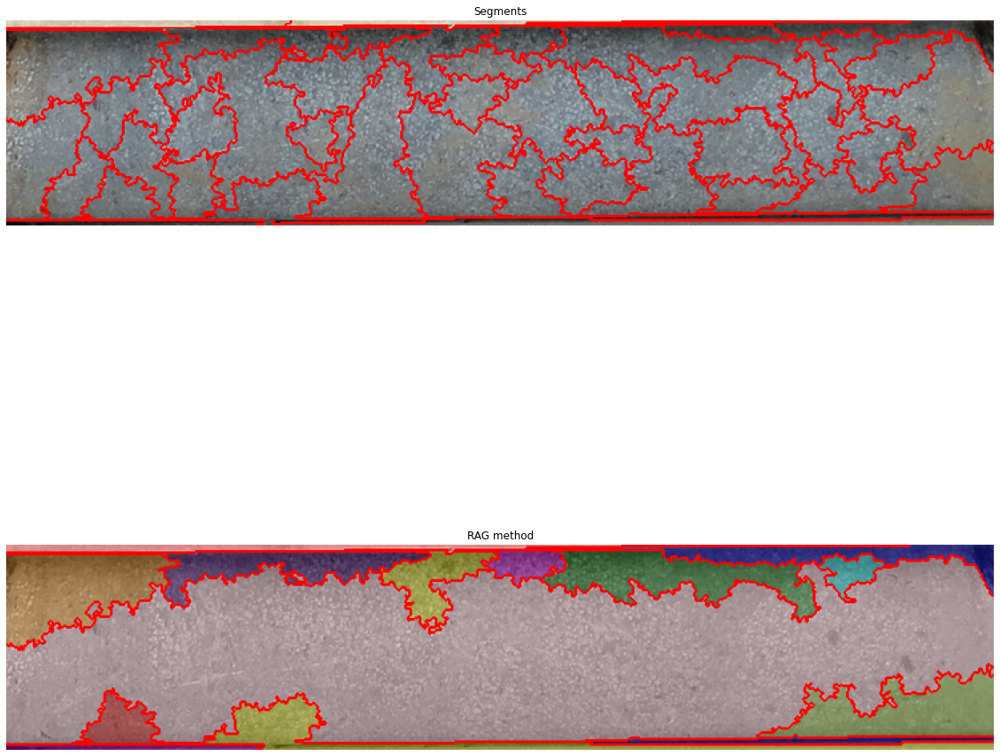

    centroid-0  centroid-1  ...    perimeter  eccentricity
0            1         229  ...  1151.520815      0.999962
1            6         612  ...   840.699531      0.998177
2           25         320  ...   475.628463      0.709917
3           13         388  ...   227.710678      0.922982
4           23         502  ...   739.919877      0.985963
5           15         198  ...   783.788889      0.990559
6           33          50  ...   530.220346      0.892319
7           20         633  ...   199.474134      0.768045
8           84         371  ...  3160.033801      0.986825
9          125         672  ...   676.581782      0.966590
10         134          85  ...   269.645707      0.708654
11         146         596  ...   616.349242      0.999864
12         143         348  ...  1395.545202      0.998862
13         151          95  ...   391.656854      0.999795

[14 rows x 9 columns]
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14]
dominant colors: [[190.77124 176.70589 151.52614

[136.6875     111.0625     106.57291667] 2.02%
[188.70866142 173.85433071 148.90944882] 5.39%
[220.55072464 217.84347826 191.99565217] 14.52%
[208.73261206 198.99381762 173.99536321] 27.18%
[-4.57589522e-12  2.52953214e-12  3.72324394e-12] 50.89%


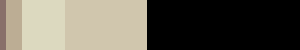

dominant colors: [[5.8569107e-04 5.3162733e-04 4.3251034e-04]
 [8.1232948e+01 7.8564217e+01 7.8460587e+01]
 [6.1400822e+01 6.2395523e+01 6.1266624e+01]
 [1.7289616e+02 1.5142076e+02 1.3398907e+02]
 [3.2891697e+01 3.0898916e+01 2.7436823e+01]]


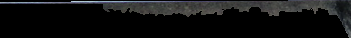

[173.85393258 152.71348315 134.93258427] 1.33%
[33.49652778 31.5        28.04513889] 2.16%
[83.07121364 79.65396189 79.58174524] 7.45%
[62.11945205 63.18246575 62.11287671] 13.71%
[0.00646766 0.00587065 0.00477612] 75.35%


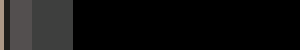

dominant colors: [[ 93.59629   97.146935  98.80314 ]
 [  0.         0.         0.      ]
 [135.93175  143.86647  147.83086 ]
 [112.85281  120.5873   125.68831 ]
 [ 69.80334   71.53333   71.39333 ]]


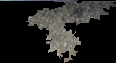

[135.53735632 143.48275862 147.50862069] 4.76%
[69.13005272 70.85061511 70.71528998] 7.79%
[92.54034582 95.9610951  97.43948127] 9.50%
[112.2        119.75972222 124.75694444] 9.85%
[-2.84217094e-13 -2.06057393e-13 -1.98951966e-12] 68.10%


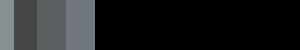

dominant colors: [[1.1161539e+02 1.1473427e+02 1.1684615e+02]
 [2.2977129e-04 2.6512070e-04 3.0047016e-04]
 [7.6375740e+01 8.0124260e+01 8.1633141e+01]
 [5.9043625e+01 6.1406040e+01 6.2590603e+01]
 [9.2663666e+01 9.6966972e+01 9.9369370e+01]]


[110.74074074 113.55555556 115.59259259] 6.89%
[58.53024911 60.88256228 62.03558719] 11.90%
[75.36060606 78.9969697  80.48181818] 14.07%
[91.36283186 95.88495575 98.30678466] 14.41%
[0.02096774 0.02419355 0.02741935] 52.72%


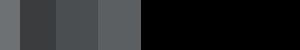

dominant colors: [[131.07162  141.33203  147.07162 ]
 [  0.         0.         0.      ]
 [ 88.31289   95.08135   98.287865]
 [106.77197  115.36865  120.481445]
 [ 65.25125   68.155     68.643745]]


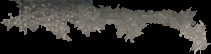

[131.11357702 141.3616188  147.10052219] 6.72%
[65.93772033 68.98824912 69.5640423 ] 7.51%
[88.94918444 95.81053952 99.08908407] 13.95%
[107.00249626 115.61058412 120.74388417] 17.58%
[ 4.94537744e-12  3.09086090e-12 -3.04112291e-12] 54.24%


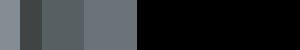

dominant colors: [[108.08236  110.76471  114.151634]
 [  0.         0.         0.      ]
 [ 86.03413   88.274605  89.884125]
 [154.01     151.39499  143.405   ]
 [ 64.472664  66.733116  67.06238 ]]


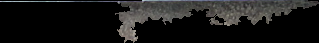

[155.15263158 152.57368421 144.12105263] 1.39%
[108.16624365 110.83502538 114.15736041] 5.74%
[85.42944785 87.69478528 89.27147239] 9.51%
[64.10480641 66.30774366 66.61815754] 10.92%
[-3.43902684e-12 -3.35020900e-12  1.91491267e-12] 72.44%


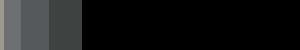

dominant colors: [[1.16472244e-02 7.95555301e-03 6.28507091e-03]
 [1.17996811e+02 1.20486984e+02 1.20785980e+02]
 [9.44489975e+01 9.42107010e+01 9.18444824e+01]
 [6.82802200e+01 6.65604401e+01 6.45934067e+01]
 [1.41941544e+02 1.44323776e+02 1.42451569e+02]]


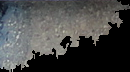

[68.28021978 66.56043956 64.59340659] 11.72%
[94.52069536 94.33774834 92.02731788] 12.91%
[142.26780459 144.64743967 142.74573278] 18.09%
[118.38445488 120.85654669 121.11111111] 20.49%
[0.36643438 0.25029036 0.19773519] 36.79%


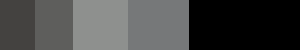

dominant colors: [[106.81609 114.86207 119.5    ]
 [ 92.54874  99.05776 101.81227]
 [121.44975 131.02393 137.66507]
 [ 79.64462  83.52066  86.14876]
 [  0.        0.        0.     ]]


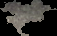

[78.16931217 81.62962963 84.15343915] 9.16%
[103.33668342 111.15577889 115.03015075] 9.45%
[120.27385892 129.7219917  136.31120332] 11.74%
[89.94505495 96.00732601 98.78388278] 13.60%
[ 4.76063633e-13  6.82121026e-13 -7.67386155e-13] 56.04%


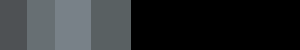

dominant colors: [[1.15094025e+02 1.20740486e+02 1.24136574e+02]
 [1.45137880e-03 1.08853413e-03 9.33029281e-04]
 [1.28061569e+02 1.35670822e+02 1.39475464e+02]
 [9.66592407e+01 1.00016006e+02 1.01038666e+02]
 [1.45096191e+02 1.55202957e+02 1.60335190e+02]]


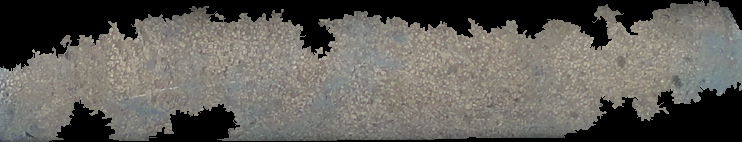

[100.91964881 104.75783507 106.33807513] 8.45%
[147.71978844 158.10927053 163.27681868] 9.50%
[130.8253688  138.91564581 143.00662179] 25.93%
[118.41720372 124.52991656 128.03432603] 27.95%
[0.00188679 0.00141509 0.00121294] 28.17%


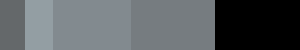

dominant colors: [[121.86907  123.324814 116.46168 ]
 [127.78369  135.73167  137.4338  ]
 [108.07289  111.51747  110.246994]
 [ 90.869835  92.67381   90.11945 ]
 [  0.         0.         0.      ]]


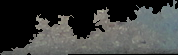

[90.85736196 92.65490798 90.10736196] 6.66%
[128.608 136.732 138.516] 7.64%
[108.08179582 111.37453875 109.8296433 ] 16.70%
[121.62935859 123.43392165 117.17219113] 23.66%
[-2.60058641e-12 -3.86535248e-12  5.40012479e-12] 45.34%


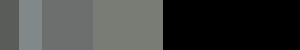

dominant colors: [[115.29225  122.056335 124.85563 ]
 [  0.         0.         0.      ]
 [132.45     141.       143.1375  ]
 [107.63356  111.729454 113.17637 ]
 [ 92.569664  94.4754    94.233604]]


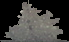

[130.46078431 138.82352941 140.85294118] 3.49%
[91.20689655 92.90147783 92.50738916] 7.00%
[105.90063425 109.56448203 110.59830867] 16.56%
[114.06017192 120.43982808 123.20630372] 23.88%
[ 6.82121026e-13 -1.49213975e-12 -1.18660637e-12] 49.07%


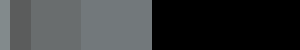

dominant colors: [[63.714287 64.39561  62.46154 ]
 [ 0.        0.        0.      ]
 [81.07971  82.39855  79.93116 ]
 [37.444168 36.600494 37.01489 ]
 [48.886646 48.8539   47.874054]]


[81.93548387 83.33064516 80.91129032] 11.54%
[65.74904943 66.48669202 64.35361217] 12.24%
[49.93430657 49.91484185 48.97323601] 19.13%
[37.78688525 37.00234192 37.2763466 ] 19.87%
[-4.19220214e-13 -6.46593890e-13  5.54223334e-13] 37.23%


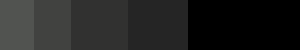

dominant colors: [[1.21513779e+02 1.25467010e+02 1.24239594e+02]
 [8.03882065e+01 8.14801102e+01 7.86392288e+01]
 [4.93468742e+01 4.75984383e+01 4.55031242e+01]
 [1.03225792e+02 1.05831085e+02 1.04122749e+02]
 [2.48261262e-03 1.87108666e-03 1.77068694e-03]]


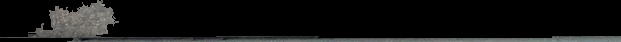

[49.56548536 47.83975347 45.72881356] 2.49%
[80.97593583 82.13903743 79.3302139 ] 2.87%
[121.80013236 125.77829252 124.59563203] 5.72%
[103.68131257 106.30311457 104.57675195] 6.96%
[0.01272455 0.00959019 0.0090756 ] 81.96%


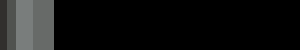

dominant colors: [[4.6206142e+01 4.3776318e+01 4.2236843e+01]
 [7.5445541e+01 7.7178215e+01 7.2594055e+01]
 [4.8090471e-03 3.7080748e-03 3.1708004e-03]
 [3.4036083e+01 3.0855669e+01 2.8690722e+01]
 [5.9808609e+01 5.9425835e+01 5.6617222e+01]]


[75.67346939 77.44897959 72.83673469] 10.10%
[35.11386139 31.80693069 29.75247525] 20.82%
[60.16585366 59.79512195 56.97073171] 21.13%
[46.75       44.54090909 42.88636364] 22.68%
[2.75918367 2.16734694 1.87346939] 25.26%


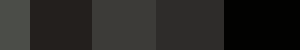

14
    centroid-0  ...                                    pallete colours
0            1  ...  [[190.77124, 176.70589, 151.52614], [209.55785...
1            6  ...  [[0.0005856911, 0.00053162733, 0.00043251034],...
2           25  ...  [[93.59629, 97.146935, 98.80314], [0.0, 0.0, 0...
3           13  ...  [[111.61539, 114.73427, 116.84615], [0.0002297...
4           23  ...  [[131.07162, 141.33203, 147.07162], [0.0, 0.0,...
5           15  ...  [[108.08236, 110.76471, 114.151634], [0.0, 0.0...
6           33  ...  [[0.011647224, 0.007955553, 0.006285071], [117...
7           20  ...  [[106.81609, 114.86207, 119.5], [92.54874, 99....
8           84  ...  [[115.094025, 120.740486, 124.13657], [0.00145...
9          125  ...  [[121.86907, 123.324814, 116.46168], [127.7836...
10         134  ...  [[115.29225, 122.056335, 124.85563], [0.0, 0.0...
11         146  ...  [[63.714287, 64.39561, 62.46154], [0.0, 0.0, 0...
12         143  ...  [[121.51378, 125.46701, 124.23959], [80.38821,...
13 

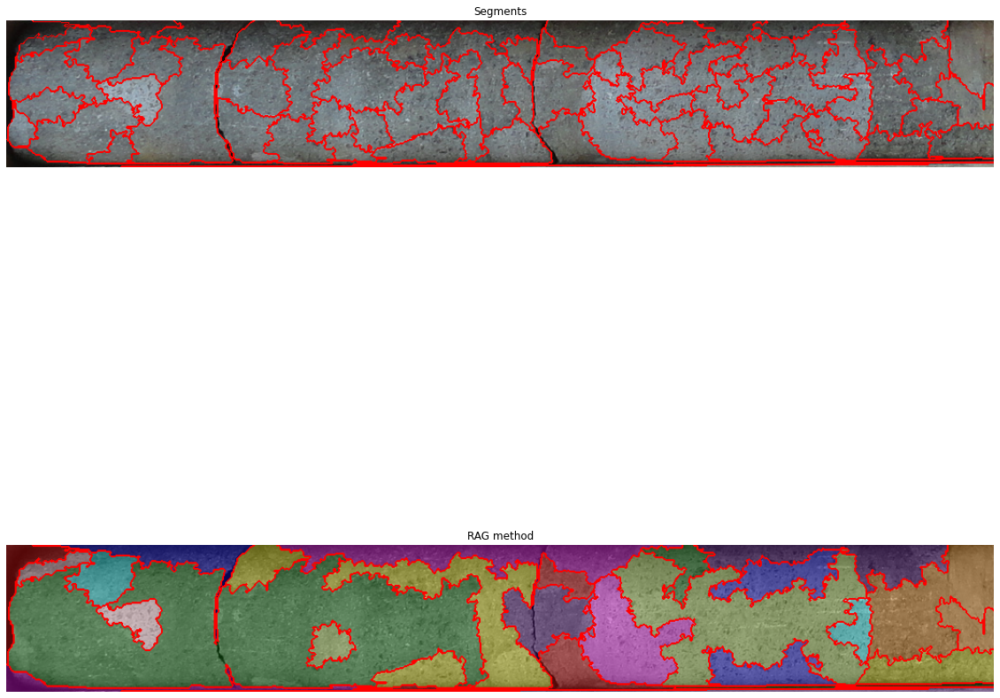

    centroid-0  centroid-1  ...    perimeter  eccentricity
0           28          20  ...   424.095454      0.882954
1           13         180  ...   722.391919      0.959740
2           22         270  ...   285.249783      0.876933
3           11         507  ...  1264.523953      0.996484
4           23         716  ...   382.113744      0.449036
5           14         881  ...   898.535101      0.990298
6           63         979  ...   878.582828      0.833479
7           34         103  ...   341.001046      0.618269
8           23          48  ...   255.066017      0.981675
9           79         782  ...  2043.730194      0.894574
10          37         591  ...   249.858910      0.899523
11          34         820  ...   633.399062      0.955148
12          83         482  ...  1655.858044      0.671784
13         100         658  ...   671.334091      0.634520
14          90         246  ...  2788.536326      0.969004
15          76         572  ...   546.179762      0.7290

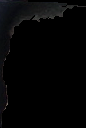

[56.47706422 58.03669725 59.53211009] 0.99%
[39.5797546  39.17177914 39.19631902] 2.96%
[27.81214421 25.25996205 23.96963947] 4.79%
[17.44926108 14.47093596 13.81182266] 9.22%
[0.00321116 0.0029897  0.00487211] 82.04%


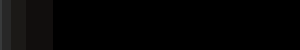

dominant colors: [[5.0622364e+01 5.0252060e+01 4.9399632e+01]
 [3.9364895e+01 3.5472691e+01 3.5418064e+01]
 [6.5901100e+01 6.8078300e+01 6.7833794e+01]
 [8.2354225e+01 8.6079018e+01 8.7204361e+01]
 [7.1226051e-03 6.7971433e-03 8.6810663e-03]]


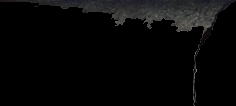

[82.22520107 85.94906166 87.03485255] 1.49%
[65.77716644 67.9477304  67.68638239] 2.91%
[50.58839779 50.20257827 49.36464088] 4.34%
[39.36489439 35.47268755 35.41806264] 5.49%
[0.05303631 0.05061285 0.06464091] 85.77%


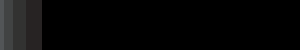

dominant colors: [[  0.         0.         0.      ]
 [103.212715 109.94621  112.94132 ]
 [ 84.90133   89.43643   92.20303 ]
 [ 66.07981   68.86268   69.35211 ]
 [ 49.131386  49.15876   48.14051 ]]


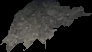

[102.44494382 109.04044944 112.07191011] 9.32%
[48.58089669 48.4502924  47.46783626] 10.72%
[83.39146568 87.82931354 90.47866419] 11.25%
[65.22407628 67.92967819 68.25029797] 17.54%
[-1.09423581e-12  2.34479103e-13 -1.19371180e-12] 51.17%


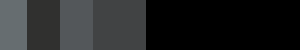

dominant colors: [[6.7955009e+01 6.8829048e+01 6.5595116e+01]
 [5.2911388e+01 5.2932636e+01 5.0020851e+01]
 [3.9704876e+01 3.6309238e+01 3.3979897e+01]
 [8.6431496e+01 8.8062279e+01 8.4657471e+01]
 [3.9344179e-03 3.2055832e-03 2.2768024e-03]]


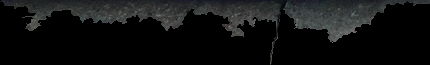

[86.43149466 88.06227758 84.65747331] 4.02%
[67.93886276 68.81188542 65.57845233] 8.35%
[39.69065981 36.29605827 33.96786632] 8.36%
[52.88848777 52.90252708 49.99077417] 8.92%
[0.03102747 0.02527976 0.01795524] 70.34%


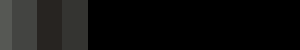

dominant colors: [[  0.         0.         0.      ]
 [ 66.56093   67.        64.69826 ]
 [120.41367  127.72638  131.70032 ]
 [ 83.50969   85.4438    84.10659 ]
 [ 99.76261  104.388664 106.11975 ]]


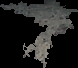

[120.14649682 127.44585987 131.44267516] 5.94%
[65.         65.29234339 63.09280742] 8.13%
[ 98.73193916 103.10836502 104.61026616] 9.90%
[81.25321101 83.         81.28807339] 10.28%
[-1.11199938e-12  6.99884595e-13 -1.04094511e-12] 65.76%


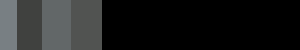

dominant colors: [[9.05023270e+01 9.39158401e+01 9.27554703e+01]
 [5.30043449e+01 5.31077347e+01 5.04226761e+01]
 [7.30572433e+01 7.55247726e+01 7.33689270e+01]
 [1.14289749e+02 1.17041031e+02 1.16005135e+02]
 [7.19506934e-04 5.98527899e-04 5.73058613e-04]]


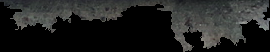

[108.75523349 111.77777778 110.90821256] 4.42%
[86.22318998 89.47577572 88.06804573] 13.08%
[51.01182796 50.78494624 47.9688172 ] 13.25%
[68.37576375 70.4898167  68.2209776 ] 13.99%
[0.00708946 0.00592936 0.00567156] 55.26%


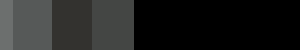

dominant colors: [[1.25503510e+02 1.30373718e+02 1.28463486e+02]
 [9.44274979e+01 9.62452164e+01 9.50150528e+01]
 [1.08449234e+02 1.11776497e+02 1.09900284e+02]
 [7.19625549e+01 6.87919617e+01 6.38945923e+01]
 [4.23168996e-03 3.70845152e-03 3.25715845e-03]]


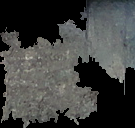

[72.15395095 69.02724796 64.19073569] 4.24%
[125.50351541 130.37371552 128.46349378] 10.70%
[94.60026918 96.48485868 95.23990579] 17.14%
[108.55027647 111.86237968 109.98771247] 28.33%
[0.09456299 0.08287051 0.07278574] 39.59%


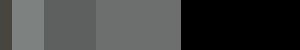

dominant colors: [[  0.         0.         0.      ]
 [112.543396 120.58616  123.92956 ]
 [ 60.959732  62.794186  64.05369 ]
 [ 80.417015  85.1722    86.44191 ]
 [ 96.36303  102.96493  105.04739 ]]


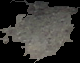

[62.48747592 64.55298651 65.8265896 ] 10.30%
[115.10463122 123.20411664 126.81818182] 11.57%
[85.41678521 90.78236131 92.16073969] 13.95%
[100.16427105 107.25359343 109.60780287] 19.33%
[ 1.54187774e-12  1.24344979e-12 -1.31450406e-12] 44.86%


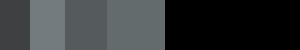

dominant colors: [[88.33993  94.09091  96.70751 ]
 [52.189655 53.568966 55.83621 ]
 [ 0.        0.        0.      ]
 [65.36709  68.       70.398735]
 [76.18765  80.346794 83.10927 ]]


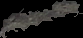

[53.25925926 54.68888889 56.82962963] 4.28%
[89.39534884 95.13023256 97.73488372] 6.88%
[66.63661972 69.45070423 71.94084507] 11.26%
[77.47880299 81.90024938 84.67581047] 12.65%
[-5.22248911e-13 -1.49213975e-13  5.75539616e-13] 64.93%


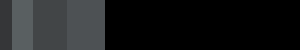

dominant colors: [[1.23180695e+02 1.31293930e+02 1.35245895e+02]
 [3.01021384e-04 3.01021384e-04 3.01021384e-04]
 [1.37170151e+02 1.46331268e+02 1.50775909e+02]
 [1.10024574e+02 1.15835197e+02 1.19192078e+02]
 [9.11712723e+01 9.48461533e+01 9.64662170e+01]]


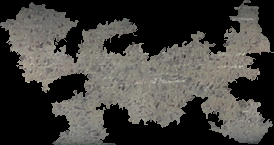

[89.96969697 93.55026455 95.04810005] 5.28%
[136.54114822 145.69286182 150.09779524] 11.42%
[108.75463679 114.38311437 117.67001546] 13.17%
[122.40073997 130.36952249 134.29402243] 21.69%
[0.00223435 0.00223435 0.00223435] 48.44%


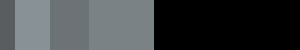

dominant colors: [[ 98.4906   101.273506  96.88034 ]
 [111.09069  114.94118  112.15932 ]
 [ 86.59048   88.55556   85.1619  ]
 [ 72.53333   73.22222   68.94444 ]
 [  0.         0.         0.      ]]


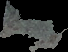

[77.76262626 79.04545455 75.67676768] 5.60%
[113.90118577 117.85770751 115.54940711] 7.27%
[103.07708779 106.3490364  102.26766595] 13.09%
[92.48958333 94.775      90.60416667] 13.57%
[-3.05533376e-13  9.66338121e-13  6.39488462e-13] 60.46%


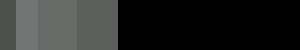

dominant colors: [[121.61722  129.94019  132.76674 ]
 [  0.         0.         0.      ]
 [ 95.326515  99.954994 101.73814 ]
 [108.047935 114.27769  116.53719 ]
 [ 76.95965   79.61053   82.06141 ]]


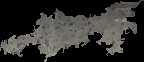

[75.99029126 78.55145631 81.01553398] 5.63%
[121.34288991 129.59977064 132.42889908] 9.77%
[ 94.54024896  99.05477178 100.84813278] 13.44%
[107.46308186 113.64606742 115.87399679] 14.15%
[-4.76063633e-12  4.23483471e-12  6.49436060e-12] 57.01%


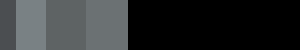

dominant colors: [[ 91.68238   93.92384   91.74527 ]
 [107.23642  112.303375 112.588005]
 [  0.         0.         0.      ]
 [ 71.35025   72.3314    69.71501 ]
 [124.08973  131.3577   132.756   ]]


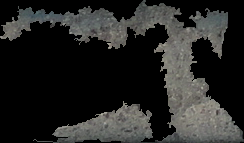

[73.35610641 74.31801693 71.60338573] 4.61%
[123.94676202 131.15454907 132.50933651] 7.16%
[92.45374677 94.83333333 92.73540052] 11.22%
[107.24264871 112.33176207 112.66397306] 12.83%
[0.00339346 0.00325951 0.00285765] 64.19%


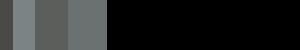

dominant colors: [[121.61402 129.12477 133.78598]
 [103.18706 107.40084 109.37271]
 [  0.        0.        0.     ]
 [146.14919 158.5774  166.72472]
 [133.03186 143.2695  149.30302]]


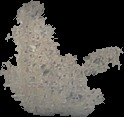

[102.52265861 106.60725076 108.49848943] 4.57%
[146.60146862 159.11348465 167.30440587] 10.46%
[121.40246688 128.87848333 133.50388305] 15.08%
[133.25216554 143.5226179  149.60571062] 21.35%
[-3.90798505e-12  7.50333129e-12 -8.41282599e-12] 48.54%


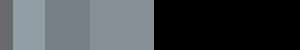

dominant colors: [[9.02761240e-03 9.00996290e-03 9.80418082e-03]
 [1.32002380e+02 1.42471649e+02 1.46008438e+02]
 [1.02641853e+02 1.08606071e+02 1.10408806e+02]
 [8.21723557e+01 8.48255234e+01 8.33892288e+01]
 [1.15953400e+02 1.24561745e+02 1.27605034e+02]]


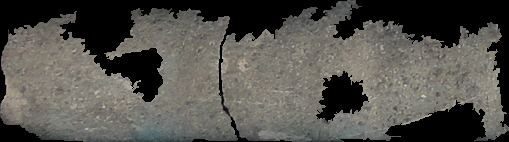

[83.39050681 86.17076399 84.91017398] 7.22%
[132.35171902 142.8043532  146.36111798] 11.19%
[103.50885042 109.62562407 111.55871102] 21.27%
[116.38961161 125.11967383 128.17736614] 29.50%
[0.04594655 0.04585673 0.04989894] 30.80%


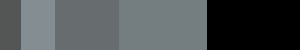

dominant colors: [[1.13494957e+02 1.18856628e+02 1.19233429e+02]
 [2.52170255e-03 2.61626625e-03 2.88734934e-03]
 [9.75314713e+01 1.01250000e+02 1.02101395e+02]
 [4.55806465e+01 4.54301071e+01 4.71075287e+01]
 [1.30553635e+02 1.37625397e+02 1.39532333e+02]]


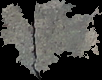

[50.83838384 51.03030303 52.67676768] 1.21%
[135.26621622 142.71486486 145.25135135] 9.07%
[105.02651515 109.40277778 109.84532828] 19.41%
[118.01930671 123.9482229  124.54322071] 27.93%
[0.16570272 0.16685946 0.18218623] 42.38%


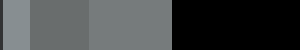

dominant colors: [[107.185425 109.425    105.77709 ]
 [  0.         0.         0.      ]
 [119.77318  123.294334 118.49595 ]
 [129.6387   133.6084   127.62937 ]
 [  0.         0.         0.      ]]


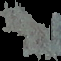

[102.80590717 104.70042194 101.34177215] 6.37%
[131.83098592 135.57042254 129.45070423] 7.58%
[113.91666667 116.94618056 112.72048611] 15.51%
[122.11375948 125.83423619 120.76489707] 24.83%
[-8.24229573e-13 -2.13162821e-12  2.45847787e-12] 45.71%


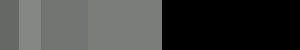

dominant colors: [[114.05369  122.9396   130.00671 ]
 [145.64456  157.09283  162.59947 ]
 [  0.         0.         0.      ]
 [127.997894 138.96011  145.46169 ]
 [ 94.93507  101.818184 109.09091 ]]


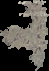

[157.84166667 169.39166667 174.525     ] 3.22%
[104.44651163 112.39069767 119.68837209] 6.18%
[135.29192547 146.54503106 152.74689441] 18.65%
[123.50275482 133.97107438 140.5261708 ] 20.95%
[ 1.36424205e-12 -3.31112915e-12  1.26476607e-12] 50.99%


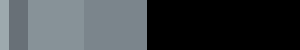

dominant colors: [[  0.         0.         0.      ]
 [158.62735  172.5925   181.6689  ]
 [134.91798  144.52367  151.0347  ]
 [117.702965 125.47524  132.61386 ]
 [147.05676  159.14055  166.64459 ]]


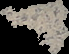

[122.93406593 131.04395604 137.90659341] 4.83%
[140.07361963 150.72801636 157.49897751] 13.10%
[160.79693487 174.88505747 184.08812261] 14.01%
[150.50492264 163.37412096 171.45428973] 19.16%
[-2.06057393e-12 -2.72848411e-12  2.82796009e-12] 48.90%


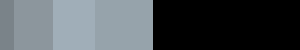

dominant colors: [[  0.         0.         0.      ]
 [113.23368  122.30585  126.49485 ]
 [103.32353  108.9853   113.01471 ]
 [137.30669  148.91792  153.46004 ]
 [123.577385 134.0134   138.56995 ]]


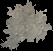

[107.5027933  114.89385475 118.70949721] 6.73%
[140.9298893  153.04428044 157.53136531] 10.03%
[118.56349206 128.52380952 133.11309524] 18.57%
[128.52407407 139.24259259 143.77222222] 19.94%
[1.10844667e-12 4.97379915e-13 1.98951966e-12] 44.73%


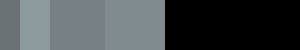

dominant colors: [[5.45583107e-03 4.89898585e-03 3.82283563e-03]
 [9.45267715e+01 9.65828094e+01 9.20647507e+01]
 [6.48493881e+01 6.40420609e+01 6.04572601e+01]
 [3.45019684e+01 3.14454651e+01 3.00026264e+01]
 [1.12409317e+02 1.16696335e+02 1.14682190e+02]]


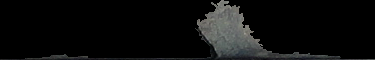

[64.82472826 64.02038043 60.4388587 ] 3.27%
[34.50197109 31.44546649 30.00262812] 3.38%
[94.36662453 96.41213654 91.83817952] 3.49%
[112.3127572  116.57860082 114.57283951] 5.43%
[0.04590198 0.04121703 0.03216297] 84.43%


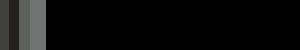

dominant colors: [[126.13431  132.78174  134.4302  ]
 [  0.         0.         0.      ]
 [101.415146 104.148964 103.310135]
 [ 80.878044  82.914635  80.82926 ]
 [114.8177   119.55836  120.36995 ]]


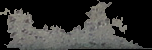

[79.91946309 81.87695749 79.75615213] 5.89%
[ 99.61728395 102.23319616 101.20576132] 9.66%
[125.32479414 131.84446478 133.46294602] 14.34%
[113.52067381 118.02526799 118.67611026] 17.14%
[ 2.69295697e-12  2.30215846e-12 -4.63273864e-12] 52.96%


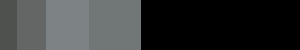

dominant colors: [[8.0895020e+01 8.2816093e+01 7.9080460e+01]
 [1.1378255e+02 1.1882693e+02 1.1506953e+02]
 [9.7229424e+01 1.0053874e+02 9.6684021e+01]
 [1.6339151e-04 1.7596009e-04 1.3825436e-04]
 [5.5134613e+01 5.6157341e+01 5.1655594e+01]]


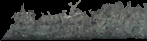

[54.29236499 55.29795158 50.82122905] 8.91%
[113.69927007 118.70510949 114.92408759] 11.37%
[80.19140625 82.05078125 78.25      ] 21.02%
[ 96.86494422 100.16500294  96.34879624] 28.47%
[0.01427003 0.01536773 0.01207464] 30.23%


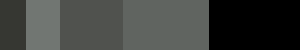

dominant colors: [[5.26921959e+01 5.19248886e+01 4.89705467e+01]
 [1.61578995e-04 1.55364425e-04 9.32186522e-05]
 [7.22317505e+01 7.31206360e+01 6.99047623e+01]
 [1.98054295e+01 1.72398186e+01 1.51327305e+01]
 [3.67352562e+01 3.41494102e+01 3.18938408e+01]]


[74.21923077 75.23846154 72.01153846] 1.65%
[19.90746269 17.33283582 15.20746269] 4.24%
[54.04215116 53.34593023 50.37790698] 4.35%
[37.25062344 34.78678304 32.50249377] 5.07%
[0.00194247 0.00186776 0.00112066] 84.69%


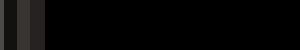

dominant colors: [[6.44605865e+01 6.53485489e+01 6.41078873e+01]
 [2.52920931e-04 1.91232903e-04 1.85064098e-04]
 [2.72191238e+01 2.50557785e+01 2.52749004e+01]
 [1.02703026e+02 1.07060600e+02 1.05412117e+02]
 [4.33301888e+01 4.23050308e+01 4.19150925e+01]]


[102.7030303  107.06060606 105.41212121] 6.95%
[64.46058091 65.34854772 64.10788382] 10.16%
[43.33018868 42.30503145 41.91509434] 13.40%
[27.21912351 25.05577689 25.2749004 ] 21.15%
[0.03574542 0.02702703 0.02615519] 48.34%


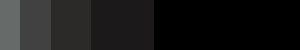

dominant colors: [[1.1998240e+02 1.2296480e+02 1.1823360e+02]
 [1.7351967e-04 1.6112540e-04 1.7971679e-04]
 [9.3318489e+01 9.3681519e+01 9.0253899e+01]
 [1.4863907e+02 1.5155000e+02 1.4394063e+02]
 [6.6743088e+01 6.6422928e+01 6.4328064e+01]]


[66.77952756 66.47637795 64.3976378 ] 5.47%
[93.35714286 93.71205357 90.27232143] 9.71%
[119.9824 122.9648 118.2336] 13.51%
[148.6390625 151.55      143.940625 ] 13.84%
[0.01053424 0.00978179 0.01091046] 57.47%


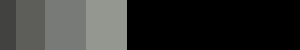

26
    centroid-0  ...                                    pallete colours
0           28  ...  [[40.16129, 39.8739, 40.005863], [0.0001797279...
1           13  ...  [[50.622364, 50.25206, 49.39963], [39.364895, ...
2           22  ...  [[0.0, 0.0, 0.0], [103.212715, 109.94621, 112....
3           11  ...  [[67.95501, 68.82905, 65.595116], [52.91139, 5...
4           23  ...  [[0.0, 0.0, 0.0], [66.56093, 67.0, 64.69826], ...
5           14  ...  [[90.50233, 93.91584, 92.75547], [53.004345, 5...
6           63  ...  [[125.50351, 130.37372, 128.46349], [94.4275, ...
7           34  ...  [[0.0, 0.0, 0.0], [112.543396, 120.58616, 123....
8           23  ...  [[88.33993, 94.09091, 96.70751], [52.189655, 5...
9           79  ...  [[123.180695, 131.29393, 135.2459], [0.0003010...
10          37  ...  [[98.4906, 101.273506, 96.88034], [111.09069, ...
11          34  ...  [[121.61722, 129.94019, 132.76674], [0.0, 0.0,...
12          83  ...  [[91.68238, 93.92384, 91.74527], [107.23642, 1...
13 

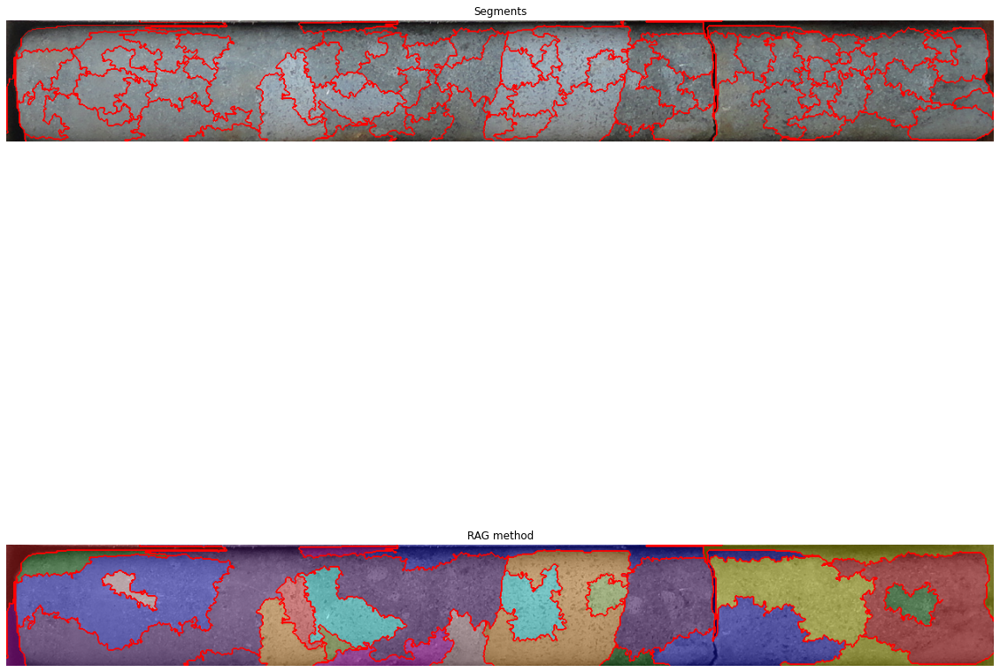

    centroid-0  centroid-1  ...    perimeter  eccentricity
0           17          76  ...   804.325902      0.967497
1           12         722  ...  1711.896536      0.995769
2           12        1105  ...  1092.261977      0.989615
3            7         427  ...   297.982756      0.995537
4           20          84  ...   599.663997      0.989675
5           77         354  ...  3270.293685      0.977622
6           85         708  ...  1404.200144      0.643842
7           85         431  ...   628.848809      0.847870
8           55         155  ...   288.586832      0.944996
9           63         762  ...   263.900541      0.569779
10          83         372  ...   388.119841      0.925203
11          64         151  ...  1388.164610      0.919829
12          61        1009  ...   964.193001      0.911590
13         119           8  ...   227.870058      0.977034
14          73        1154  ...   339.391919      0.782987
15          74         839  ...   602.173665      0.6572

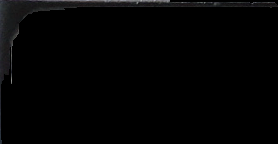

[126.24342105 121.38815789 122.22368421] 0.38%
[80.71808511 78.18617021 79.04255319] 0.47%
[47.25186104 43.84491315 43.02605459] 2.01%
[28.37044638 26.80041047 27.21806054] 4.87%
[0.00067683 0.00054146 0.00059561] 92.27%


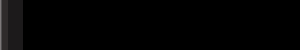

dominant colors: [[3.1033924e+01 2.9015190e+01 2.8597469e+01]
 [7.6501991e+01 7.9089943e+01 7.8050507e+01]
 [1.8853005e-02 1.4899522e-02 1.6168941e-02]
 [5.5366817e+01 5.6234024e+01 5.4476521e+01]
 [1.1221616e+02 1.1500202e+02 1.1583940e+02]]


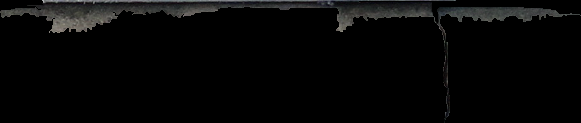

[112.40672783 115.17023445 115.98470948] 1.37%
[31.12788365 29.15646941 28.72768305] 2.79%
[76.62566607 79.22335702 78.22113677] 3.15%
[55.53143078 56.39336676 54.62128808] 3.63%
[0.05507283 0.04352403 0.04723222] 89.06%


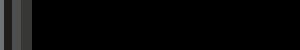

dominant colors: [[4.1638775e+01 3.9727211e+01 3.6625172e+01]
 [5.3017144e-03 4.1489368e-03 3.5911412e-03]
 [7.4710014e+01 7.7031387e+01 7.5738419e+01]
 [2.5113245e+01 2.1367271e+01 2.0090908e+01]
 [6.4594254e+01 5.4336369e+01 4.8516464e+01]]


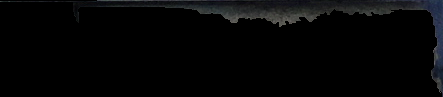

[74.99689922 77.44496124 76.20310078] 1.50%
[65.17266187 54.83165468 48.95467626] 3.24%
[42.23879599 40.2548495  37.17525084] 3.47%
[25.36806982 21.62577002 20.28747433] 4.53%
[0.03147254 0.02421785 0.0212573 ] 87.25%


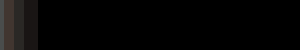

dominant colors: [[4.5525181e+01 4.6155876e+01 4.6887291e+01]
 [3.2793236e+01 3.1842106e+01 3.3233082e+01]
 [1.9973179e+01 1.7406130e+01 2.0601532e+01]
 [5.7117639e-05 4.6732614e-05 3.6347588e-05]
 [6.0660099e+01 6.3078815e+01 6.4507385e+01]]


[60.66009852 63.07881773 64.50738916] 10.74%
[19.97318008 17.40613027 20.60153257] 13.81%
[32.79323308 31.84210526 33.23308271] 14.07%
[45.52517986 46.1558753  46.88729017] 22.06%
[0.01480485 0.01211306 0.00942127] 39.31%


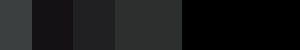

dominant colors: [[8.39405911e-05 7.34480200e-05 9.44331623e-05]
 [5.55045891e+01 5.57834854e+01 5.43412857e+01]
 [1.21878471e+02 1.26322914e+02 1.25905380e+02]
 [7.67133942e+01 7.83130798e+01 7.77865982e+01]
 [9.70166245e+01 9.97774963e+01 1.01079285e+02]]


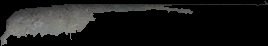

[57.69650986 58.04704097 56.75265554] 5.35%
[102.42208775 105.53706505 107.0075643 ] 5.36%
[81.88311688 83.85324675 83.76363636] 6.25%
[123.17943744 127.69059166 127.07274491] 8.36%
[0.00173781 0.00152058 0.00195503] 74.68%


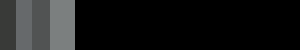

dominant colors: [[1.04232849e+02 1.09188766e+02 1.10049629e+02]
 [1.38730133e+02 1.49914001e+02 1.53866455e+02]
 [7.45005906e-02 6.63010851e-02 7.09100440e-02]
 [7.23336639e+01 7.47995987e+01 7.49950104e+01]
 [1.21708244e+02 1.29764618e+02 1.32809174e+02]]


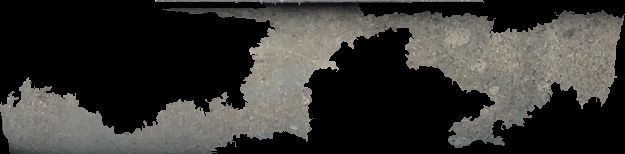

[70.83451453 73.20481928 73.40538625] 2.93%
[138.73863758 149.92492782 153.87520051] 9.72%
[103.71084583 108.63156821 109.49137843] 10.18%
[121.65005644 129.67935279 132.69870451] 19.32%
[0.18820613 0.16611284 0.17859645] 57.84%


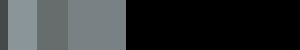

dominant colors: [[153.51497 166.66443 174.99617]
 [136.36797 144.35046 149.1822 ]
 [  0.        0.        0.     ]
 [ 91.67265  92.86243  91.89723]
 [118.32951 122.3488  124.2281 ]]


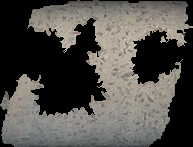

[91.54635217 92.73340647 91.76467361] 6.48%
[118.4241265  122.47640908 124.38842132] 13.85%
[153.94941147 167.17856248 175.55221638] 13.92%
[136.69643426 144.7944922  149.70678128] 22.22%
[1.34008360e-11 1.94262384e-11 2.32773800e-11] 43.54%


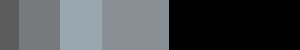

dominant colors: [[129.30083 140.88986 147.64   ]
 [116.85872 125.5928  131.5    ]
 [139.13338 152.32861 161.3152 ]
 [  0.        0.        0.     ]
 [152.02054 165.24716 173.81657]]


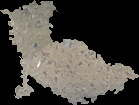

[117.93009479 126.77132701 132.66824645] 5.85%
[153.27148936 166.44595745 174.88510638] 8.22%
[130.3798294  142.23733066 149.22277973] 13.77%
[140.23527176 153.52831623 162.64614215] 17.68%
[-2.44426701e-12 -8.01492206e-12 -9.84812232e-12] 54.48%


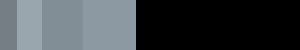

dominant colors: [[146.00201 157.3179  161.55533]
 [154.58684 167.01797 171.42516]
 [140.27217 151.04233 155.60483]
 [  0.        0.        0.     ]
 [130.39806 140.92233 146.92233]]


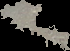

[129.19753086 139.40740741 145.9382716 ] 2.27%
[154.29608939 166.68715084 171.06703911] 5.01%
[139.80503145 150.60167715 155.09224319] 13.36%
[145.6539924  156.92965779 161.24144487] 14.73%
[ 8.59756710e-13  2.03215222e-12 -2.31636932e-12] 64.62%


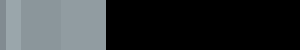

dominant colors: [[160.10909 174.13223 181.84297]
 [149.42366 162.70738 170.27608]
 [  0.        0.        0.     ]
 [136.37758 147.1888  154.78761]
 [116.98246 125.00877 135.0351 ]]


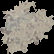

[116.98245614 125.00877193 135.03508772] 3.91%
[136.66005666 147.47308782 155.08498584] 12.21%
[160.54285714 174.56785714 182.27678571] 19.17%
[149.81640147 163.18115055 170.75275398] 27.95%
[-1.37845291e-12 -1.27897692e-12  1.54898316e-12] 36.76%


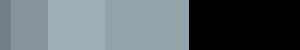

dominant colors: [[181.3869  196.05357 205.16072]
 [169.08614 183.88963 192.4051 ]
 [141.8244  151.29759 158.69316]
 [  0.        0.        0.     ]
 [158.80217 171.49774 179.30894]]


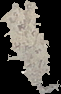

[133.83333333 141.51428571 148.42380952] 3.73%
[174.47950089 189.37254902 198.26916221] 9.96%
[150.53744493 161.79735683 169.61820852] 11.81%
[162.71093044 176.266486   184.15898826] 19.13%
[-5.42854650e-12 -4.43378667e-12  4.97379915e-12] 55.37%


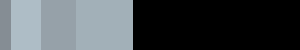

dominant colors: [[148.83559  160.39804  164.33424 ]
 [  0.         0.         0.      ]
 [136.45961  146.33992  150.1375  ]
 [127.04247  135.01674  137.86388 ]
 [105.542755 111.472786 113.55265 ]]


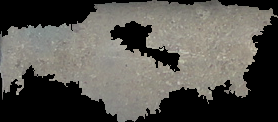

[105.0059657  110.84712901 112.88068606] 3.96%
[147.72047579 159.14018692 163.17530445] 10.19%
[126.20759671 134.11115001 136.9768948 ] 16.97%
[135.73544974 145.44359788 149.10359788] 27.95%
[ 3.43902684e-12 -2.19415597e-11 -2.19415597e-11] 40.93%


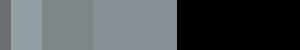

dominant colors: [[104.055824 110.88702  111.93558 ]
 [114.62544  123.35609  124.554375]
 [126.34682  136.81009  137.78873 ]
 [ 89.10048   93.19138   92.08708 ]
 [  0.         0.         0.      ]]


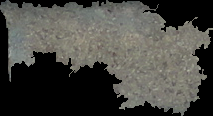

[92.35286783 96.92518703 96.39214464] 6.48%
[128.95044248 139.73893805 140.71769912] 8.99%
[108.0791893  115.76117844 116.90931885] 19.38%
[117.63819712 126.81164504 127.989302  ] 23.23%
[-9.54969437e-12 -1.04023457e-11 -9.72022463e-12] 41.91%


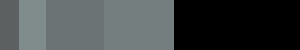

dominant colors: [[45.06757  39.216217 35.574326]
 [71.16667  70.7381   70.85715 ]
 [29.323471 26.461538 25.887575]
 [ 0.        0.        0.      ]
 [20.226786 19.114286 19.555357]]


[70.11111111 69.66666667 69.75555556] 1.68%
[43.76470588 37.96470588 34.38823529] 6.36%
[19.70658683 18.69660679 19.26746507] 18.73%
[28.43807763 25.76524954 25.28465804] 20.22%
[ 1.04805054e-13 -3.35731443e-13  2.29150032e-13] 53.01%


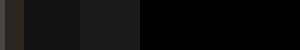

dominant colors: [[146.5      158.375    161.5     ]
 [130.68532  143.94406  146.95105 ]
 [116.545685 127.63325  130.19923 ]
 [  0.         0.         0.      ]
 [103.33409  112.6319   115.49584 ]]


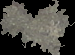

[133.06097561 146.18292683 149.21341463] 4.02%
[ 97.83148148 106.18333333 109.24814815] 12.92%
[117.97355372 129.2661157  131.79338843] 14.76%
[108.07843137 118.11455108 120.83384933] 23.52%
[-1.16529009e-12 -1.37845291e-12  2.77111667e-12] 44.78%


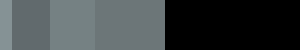

dominant colors: [[1.06925720e+02 1.14206963e+02 1.16283745e+02]
 [9.27702179e+01 9.73192139e+01 9.86512604e+01]
 [1.38137100e+02 1.49699997e+02 1.53619354e+02]
 [1.20201256e+02 1.29189804e+02 1.32000824e+02]
 [2.31156620e-04 2.53171544e-04 2.58675253e-04]]


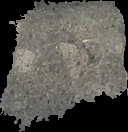

[138.30592105 149.90707237 153.82565789] 7.30%
[92.77021823 97.31921267 98.6512623 ] 13.83%
[120.27872861 129.27737028 132.09426786] 21.71%
[106.94087029 114.22111181 116.30064543] 28.40%
[0.00864375 0.00946697 0.00967277] 28.76%


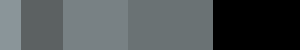

dominant colors: [[128.84586 131.54243 130.70341]
 [156.65819 169.23587 177.24011]
 [107.91579 104.61052  97.71789]
 [143.74234 151.17102 155.99329]
 [  0.        0.        0.     ]]


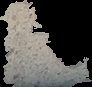

[107.79317697 104.43923241  97.4989339 ] 5.85%
[128.53507014 131.15631263 130.18136273] 12.46%
[143.34710744 150.6446281  155.36964688] 16.73%
[156.48455731 168.97254633 176.93136582] 18.13%
[ 5.54223334e-13 -4.64694949e-12 -3.31112915e-12] 46.84%


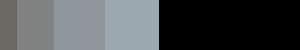

dominant colors: [[153.8703  168.39655 178.27425]
 [164.30331 179.1801  188.88467]
 [145.06024 157.31215 166.0185 ]
 [  0.        0.        0.     ]
 [129.56018 139.4297  149.1766 ]]


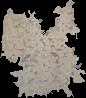

[123.15981735 132.38812785 143.07762557] 5.27%
[161.13742437 175.97666379 185.74416595] 13.89%
[140.8147224  152.0349345  160.54148472] 18.87%
[150.16089712 163.97805948 173.50219405] 24.25%
[ 5.49960077e-12 -2.78532752e-12  1.03739239e-12] 37.72%


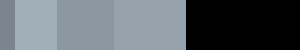

dominant colors: [[106.64581  110.13356  108.95266 ]
 [  0.         0.         0.      ]
 [ 88.00712   89.40688   85.07474 ]
 [125.26016  130.45203  130.7008  ]
 [ 63.49716   62.835228  57.71875 ]]


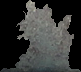

[64.36772487 63.71693122 58.71957672] 6.55%
[125.83737024 131.08823529 131.35640138] 9.91%
[88.83972125 90.35656214 86.11149826] 14.80%
[107.29761905 110.84438776 109.73214286] 20.06%
[-2.46558329e-12 -1.79056769e-12  1.10134124e-12] 48.68%


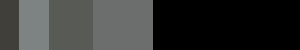

dominant colors: [[118.93112  124.39193  125.73397 ]
 [  0.         0.         0.      ]
 [127.617805 135.84818  140.05235 ]
 [ 89.04762   86.54762   81.809525]
 [109.63964  111.581085 111.5991  ]]


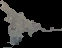

[92.50877193 90.42105263 85.98245614] 1.92%
[129.71900826 138.54545455 143.50413223] 4.07%
[111.35517241 114.29310345 114.9       ] 9.74%
[120.74264706 126.61519608 128.20833333] 13.71%
[-1.03028697e-12  1.03028697e-12 -2.98427949e-13] 70.56%


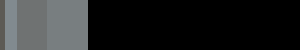

dominant colors: [[104.93028  112.08166  112.72628 ]
 [ 94.05986   99.08188   98.73193 ]
 [  0.         0.         0.      ]
 [ 73.53292   76.01046   74.73231 ]
 [115.37686  125.209015 126.37366 ]]


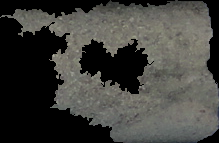

[72.11918195 74.41325811 73.01833568] 4.59%
[92.7443169  97.4710781  97.06347063] 14.12%
[114.96429326 124.67293471 125.83160786] 15.20%
[104.11721012 111.14881027 111.70728944] 25.28%
[-1.28466127e-11  8.10018719e-12  5.72697445e-12] 40.81%


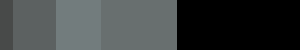

dominant colors: [[1.22688226e-02 9.97496676e-03 7.77484942e-03]
 [9.23706970e+01 9.20532761e+01 8.36156158e+01]
 [1.24514198e+02 1.30623383e+02 1.28348495e+02]
 [1.09279099e+02 1.13289139e+02 1.09732994e+02]
 [6.36155815e+01 6.15898972e+01 5.43792801e+01]]


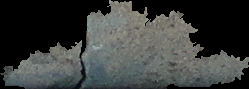

[64.14415907 62.12013256 54.89229495] 5.43%
[92.8459862  92.61205957 84.27388304] 12.44%
[124.78400683 130.90751281 128.61326124] 15.86%
[109.59065878 113.68509076 110.20069345] 22.12%
[0.23098937 0.18816435 0.14646361] 44.15%


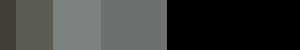

dominant colors: [[1.6265623e-04 5.7716723e-05 2.0987900e-05]
 [4.6909863e+01 3.6969387e+01 3.2127552e+01]
 [9.5507492e+01 9.7497498e+01 9.0838158e+01]
 [6.3345940e+01 6.0732494e+01 5.3558826e+01]
 [8.2874260e+01 8.3311981e+01 7.4241997e+01]]


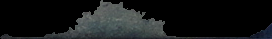

[46.90986395 36.96938776 32.12755102] 5.54%
[63.25035361 60.6251768  53.44978784] 6.66%
[82.51715686 82.91544118 73.82843137] 7.69%
[95.30724638 97.2647343  90.55362319] 9.76%
[0.00415438 0.00147414 0.00053605] 70.34%


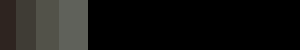

dominant colors: [[ 95.51167   93.77469   86.55745 ]
 [ 57.60969   52.691326  47.14541 ]
 [ 81.22206   75.037735  66.1524  ]
 [  0.         0.         0.      ]
 [105.95234  108.560036 105.47754 ]]


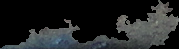

[58.42619048 53.44285714 47.83809524] 4.78%
[82.44459644 76.44733242 67.43502052] 8.35%
[106.45336008 109.23470411 106.30591775] 11.37%
[96.30843585 94.92442882 88.03778559] 12.97%
[-1.46371804e-12  4.09272616e-12  8.45545856e-13] 62.54%


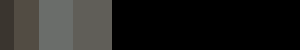

dominant colors: [[ 0.        0.        0.      ]
 [62.14433  61.340206 56.50172 ]
 [74.066666 75.56825  71.790474]
 [47.95631  46.349514 41.16505 ]
 [89.615654 92.59431  89.98576 ]]


[91.70046083 94.78801843 92.22119816] 9.03%
[48.88311688 47.25541126 42.03030303] 9.61%
[77.02265372 78.90614887 75.40776699] 12.86%
[63.94345238 63.55357143 58.92857143] 13.98%
[3.76587650e-13 2.55795385e-13 2.66453526e-13] 54.52%


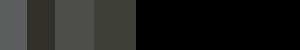

dominant colors: [[ 95.43011   92.9543    85.71774 ]
 [105.90266  106.09026   99.153984]
 [  0.         0.         0.      ]
 [116.091896 117.66757  112.78649 ]
 [ 82.51185   80.23223   72.25593 ]]


[82.78733032 80.49321267 72.63800905] 8.90%
[116.17630854 117.77410468 112.92837466] 14.75%
[95.88020833 93.5078125  86.29427083] 15.68%
[106.20545455 106.43272727  99.46      ] 22.35%
[-7.46069873e-13 -1.06581410e-13 -1.00186526e-12] 38.32%


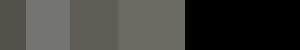

26
    centroid-0  ...                                    pallete colours
0           17  ...  [[28.370447, 26.800411, 27.218061], [0.0001311...
1           12  ...  [[31.033924, 29.01519, 28.59747], [76.50199, 7...
2           12  ...  [[41.638775, 39.72721, 36.62517], [0.005301714...
3            7  ...  [[45.52518, 46.155876, 46.88729], [32.793236, ...
4           20  ...  [[8.394059e-05, 7.344802e-05, 9.443316e-05], [...
5           77  ...  [[104.23285, 109.18877, 110.04963], [138.73013...
6           85  ...  [[153.51497, 166.66443, 174.99617], [136.36797...
7           85  ...  [[129.30083, 140.88986, 147.64], [116.85872, 1...
8           55  ...  [[146.00201, 157.3179, 161.55533], [154.58684,...
9           63  ...  [[160.10909, 174.13223, 181.84297], [149.42366...
10          83  ...  [[181.3869, 196.05357, 205.16072], [169.08614,...
11          64  ...  [[148.83559, 160.39804, 164.33424], [0.0, 0.0,...
12          61  ...  [[104.055824, 110.88702, 111.93558], [114.6254...
13 

In [5]:
for xywh in contours_x_y_w_h:
    x = xywh[0]
    y = xywh[1]
    w = xywh[2]
    h = xywh[3]

    img = box_img[y:y+h,x:x+w]
    img = cv2.cvtColor(img, cv2.COLOR_HSV2RGB)
    segments = felzenszwalb(img, min_size=500 )
    
    g = graph.rag_mean_color(img, segments)

    labels2 = graph.merge_hierarchical(segments, g, thresh=20, rag_copy=False,
                                    in_place_merge=True,
                                    merge_func=merge_mean_color,
                                    weight_func=_weight_mean_color)
    labels2 = labels2+1

    
    
    out = color.label2rgb(labels2, img, kind='overlay' )
    fig, (ax0,ax1) = plt.subplots(2, 1, figsize=(20,20))
    ax1.imshow(mark_boundaries(out, labels2, (1, 0, 0)))
    ax1.set_title('RAG method')
    ax1.axis('off')

    ax0.imshow(mark_boundaries(img, segments, color=(1,0,0)))
    ax0.set_title('Segments')
    ax0.axis('off')
    plt.show(fig)

    gray_img = cv2.cvtColor(img, cv2.COLOR_HSV2RGB)
    gray_img = cv2.cvtColor(gray_img, cv2.COLOR_RGB2GRAY)
    props = measure.regionprops_table(label_image = labels2, intensity_image = gray_img, properties=('centroid',
                                                    'orientation',
                                                    'major_axis_length',
                                                    'minor_axis_length',
                                                    'area','mean_intensity', 'perimeter', 'eccentricity'),)
    print(pd.DataFrame(props))
    print(np.unique(labels2))


    dominant_colours = []
    for index in np.unique(labels2):

        segment = img.copy()
        segment[labels2!=index] = 0
        pixels = np.float32(segment.reshape(-1, 3))
        gray = cv2.cvtColor(segment,cv2.COLOR_BGR2GRAY)
        _,thresh = cv2.threshold(gray,1,255,cv2.THRESH_BINARY)
        contours,hierarchy = cv2.findContours(thresh,cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)
        cnt = contours[0]
        x,y,w,h = cv2.boundingRect(cnt)
        segment = segment[y:y+h,x:x+w]

        n_colors = 5
        criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, .1)
        flags = cv2.KMEANS_RANDOM_CENTERS

        _, labels, palette = cv2.kmeans(pixels, n_colors, None, criteria, 10, flags)
        _, counts = np.unique(labels, return_counts=True)
        print('dominant colors:', palette)
        dominant_colours.append(palette)

        cv2_imshow(segment)
        reshape = segment.reshape((segment.shape[0] * segment.shape[1], 3))

        # Find and display most dominant colors
        cluster = KMeans(n_clusters=5).fit(reshape)
        visualize = visualize_colors(cluster, cluster.cluster_centers_)
        visualize = cv2.cvtColor(visualize, cv2.COLOR_RGB2BGR)
        cv2_imshow( visualize)




    props ['pallete colours'] = dominant_colours
    
    print(len(dominant_colours) )
    print(pd.DataFrame(props))
    pd.DataFrame(props).to_excel("output.xlsx")

**Four steps:**


1.   preprocessing
2.   segmentation

1.   Merging segments
2.   feature extraction





*What I would recommend doing to make this code useful*:

**Preproccesing**

Paint the box in a bright contrasting colour. Then we can take the tresholding and draw the contours of the exact rock samples clearly.

This will reduce the area that the rest of the segmentation and RAG algorithms will process, I think will speed up the process.



**Merging segments**

I would replace RAG for segmentation merging with the random walker algorithm.

Example of segmentation using the random walker with our approach: (left) ground truth image, (middle) rough contour drawn by the user, and (right) segmentation results:

So, the idea is simple: 

get the marked images 

Then train the neuronics based on them 

and the rest of the images would be marked by the neuronics

**Feature extraction**

I don't know what exactly needs to be done. But counting dominant colours for segments using the k-means method takes too much time. In production, I would have chosen something else. I'll have to see what other people use for this

Felzenszwalb number of segments: 300
SLIC number of segments: 245
Quickshift number of segments: 736


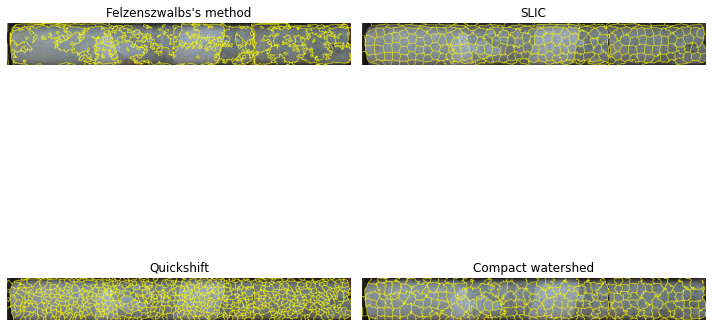

In [6]:
import matplotlib.pyplot as plt
import numpy as np

from skimage.data import astronaut
from skimage.color import rgb2gray
from skimage.filters import sobel
from skimage.segmentation import felzenszwalb, slic, quickshift, watershed
from skimage.segmentation import mark_boundaries
from skimage.util import img_as_float

segments_fz = felzenszwalb(img, scale=100, sigma=0.5, min_size=50)
segments_slic = slic(img, n_segments=250, compactness=10, sigma=1)
segments_quick = quickshift(img, kernel_size=3, max_dist=6, ratio=0.5)
gradient = sobel(rgb2gray(img))
segments_watershed = watershed(gradient, markers=250, compactness=0.001)

print(f"Felzenszwalb number of segments: {len(np.unique(segments_fz))}")
print(f"SLIC number of segments: {len(np.unique(segments_slic))}")
print(f"Quickshift number of segments: {len(np.unique(segments_quick))}")

fig, ax = plt.subplots(2, 2, figsize=(10, 10), sharex=True, sharey=True)

ax[0, 0].imshow(mark_boundaries(img, segments_fz))
ax[0, 0].set_title("Felzenszwalbs's method")
ax[0, 1].imshow(mark_boundaries(img, segments_slic))
ax[0, 1].set_title('SLIC')
ax[1, 0].imshow(mark_boundaries(img, segments_quick))
ax[1, 0].set_title('Quickshift')
ax[1, 1].imshow(mark_boundaries(img, segments_watershed))
ax[1, 1].set_title('Compact watershed')

for a in ax.ravel():
    a.set_axis_off()

plt.tight_layout()
plt.show()

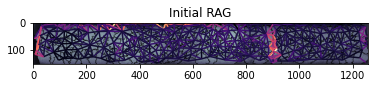

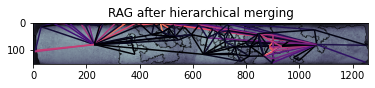

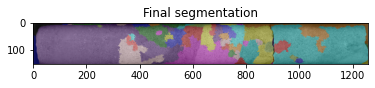

In [7]:
from skimage import data, segmentation, filters, color
from skimage.future import graph
from matplotlib import pyplot as plt


def weight_boundary(graph, src, dst, n):
    """
    Handle merging of nodes of a region boundary region adjacency graph.

    This function computes the `"weight"` and the count `"count"`
    attributes of the edge between `n` and the node formed after
    merging `src` and `dst`.


    Parameters
    ----------
    graph : RAG
        The graph under consideration.
    src, dst : int
        The vertices in `graph` to be merged.
    n : int
        A neighbor of `src` or `dst` or both.

    Returns
    -------
    data : dict
        A dictionary with the "weight" and "count" attributes to be
        assigned for the merged node.

    """
    default = {'weight': 0.0, 'count': 0}

    count_src = graph[src].get(n, default)['count']
    count_dst = graph[dst].get(n, default)['count']

    weight_src = graph[src].get(n, default)['weight']
    weight_dst = graph[dst].get(n, default)['weight']

    count = count_src + count_dst
    return {
        'count': count,
        'weight': (count_src * weight_src + count_dst * weight_dst)/count
    }


def merge_boundary(graph, src, dst):
    """Call back called before merging 2 nodes.

    In this case we don't need to do any computation here.
    """
    pass

img_rag = img.copy()
edges = filters.sobel(color.rgb2gray(img_rag))
labels = segmentation.quickshift(img_rag)
g = graph.rag_boundary(labels, edges)

graph.show_rag(labels, g, img_rag)
plt.title('Initial RAG')

labels2 = graph.merge_hierarchical(labels, g, thresh=0.05, rag_copy=False,
                                   in_place_merge=True,
                                   merge_func=merge_boundary,
                                   weight_func=weight_boundary)

graph.show_rag(labels, g, img_rag)
plt.title('RAG after hierarchical merging')

plt.figure()
out = color.label2rgb(labels2, img_rag, kind='overlay', bg_label=0)
plt.imshow(out)
plt.title('Final segmentation')

plt.show()